In [1]:
import matplotlib.pyplot as plt 
from scipy.io import readsav
import numpy as np
from astropy.io import fits
from scipy.ndimage import gaussian_filter
from matplotlib import colors
import cmasher as cmr
import sunpy.cm as cm #The functionality of the sunpy.cm module is now in sunpy.visualization.colormaps as of SunPy 1.1
from tqdm import tqdm
from helita.io import lp
import COCOpy as cp
import h5py
from mpl_toolkits.axes_grid1 import make_axes_locatable
from skimage.measure import label, regionprops
import matplotlib as mpl
from scipy import ndimage
import COCOpy as cp
import time
import multiprocessing as mp

In [2]:
dpath_SST = '/mn/stornext/d18/lapalma/reduc/2021/2021-08-04/CHROMIS/cubes_nb/'
dpath_SST_processed = '/mn/stornext/d18/lapalma/reduc/2021/2021-08-04/CHROMIS/cubes_nb/souvikb_CBP/'
dpath_EDVARDA_SDO = '/mn/stornext/d18/lapalma/reduc/2021/2021-08-04/CHROMIS/edvarda/sdo2sst/' 
dpath_SDO_BOSE ='/mn/stornext/d18/lapalma/reduc/2021/2021-08-04/CHROMIS/cubes_nb/souvikb_CBP/SDO_only_aia/'
sdo_target_cubes = '/mn/stornext/d18/lapalma/reduc/2021/2021-08-04/CHROMIS/edvarda/sdo/target/cubes/'

# SST data

In [3]:
# ---- Reduced H-beta data----
hdrH_im =lp.getheader(dpath_SST+'nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
hdrH_sp = lp.getheader(dpath_SST+'nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_sp.icube')
dimH_im = hdrH_im[0]
dimH_sp = hdrH_sp[0]
cubeH = lp.getdata(dpath_SST+'nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
cubeH = np.reshape(cubeH,[dimH_im[0],dimH_im[1],dimH_sp[1],dimH_sp[0]])

#----- Unsharp masked Dopplergram ----
hdr_dopp = lp.getheader(dpath_SST_processed+'Dopplergram_nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
dim_dopp = hdr_dopp[0]
cube_dopp = lp.getdata(dpath_SST_processed+'Dopplergram_nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
cube_dopp = np.reshape(cube_dopp,[dim_dopp[0],dim_dopp[1],dim_dopp[2]])

#------- RBE detections --------
hdr_rbe_mask = lp.getheader(dpath_SST_processed+'Unshrped_RBEs_nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
dim_rbe_mask = hdr_rbe_mask[0]
cube_rbe_mask = lp.getdata(dpath_SST_processed+'Unshrped_RBEs_nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
cube_rbe_mask = np.reshape(cube_rbe_mask,[dim_rbe_mask[0],dim_rbe_mask[1],dim_rbe_mask[2]])

#------ RRE detections --------
hdr_rre_mask = lp.getheader(dpath_SST_processed+'Unsrhped_RREs_nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
dim_rre_mask = hdr_rre_mask[0]
cube_rre_mask = lp.getdata(dpath_SST_processed+'Unsrhped_RREs_nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im.icube')
cube_rre_mask = np.reshape(cube_rre_mask,[dim_rre_mask[0],dim_rre_mask[1],dim_rre_mask[2]])
#cube_dopp=np.swapaxes(cube_dopp,0,1)

#------ Fe I 6173 AA magnetic field------
hdr_mag_los = lp.getheader(dpath_SST+'Blos_6173_09:56:56_aligned_4846_2021-08-04T09:56:50_scans=0-95.fcube')
dim_mag_los = hdr_mag_los[0]
cube_mag_los= lp.getdata(dpath_SST+'Blos_6173_09:56:56_aligned_4846_2021-08-04T09:56:50_scans=0-95.fcube')
cube_mag_los = np.reshape(cube_mag_los, [dim_mag_los[0],dim_mag_los[1],dim_mag_los[2]])

#------ Fe I 6173 AA LOS velocity field------
hdr_V_los = lp.getheader(dpath_SST+'Vlos_6173_09:56:56_aligned_4846_2021-08-04T09:56:50_scans=0-95.fcube')
dim_V_los = hdr_V_los[0]
cube_V_los= lp.getdata(dpath_SST+'Vlos_6173_09:56:56_aligned_4846_2021-08-04T09:56:50_scans=0-95.fcube')
cube_V_los = np.reshape(cube_V_los, [dim_V_los[0],dim_V_los[1],dim_V_los[2]])

#------ H-beta 4861.33 AA line-core widths (see Line_widths.ipynb/.py for more details on this) ------
hdr_lc_widths = lp.getheader(dpath_SST+'lc_widths_nb_4846_2021-08-04T09:56:50_scans=0-95.fcube')
dim_lc_widths = hdr_lc_widths[0]
cube_lc_widths = lp.getdata(dpath_SST+'lc_widths_nb_4846_2021-08-04T09:56:50_scans=0-95.fcube')
cube_lc_widths = np.reshape(cube_lc_widths, [dim_lc_widths[0],dim_lc_widths[1],dim_lc_widths[2]])

#----- time and wavelength stamps --------
time_steps = readsav(dpath_SST+'nb_4846_2021-08-04T09:56:50_scans=0-95_corrected_cmapcorr_im_times+wvl.idlsave')
times = time_steps['times']
wav = time_steps['LAMBDA']

# SDO data

In [4]:
##------ Original SDO in .fits form -----------
aia_171 = np.swapaxes(fits.getdata(dpath_SDO_BOSE+'aia_171_bose.fits',ext=0),0,2)
aia_193 = np.swapaxes(fits.getdata(dpath_SDO_BOSE+'aia_193_bose.fits',ext=0),0,2)
aia_211 = np.swapaxes(fits.getdata(dpath_SDO_BOSE+'aia_211_bose.fits',ext=0),0,2)
aia_304 = np.swapaxes(fits.getdata(dpath_SDO_BOSE+'aia_304_bose.fits',ext=0),0,2)
aia_131 = np.swapaxes(fits.getdata(dpath_SDO_BOSE+'aia_131_bose.fits',ext=0),0,2)
hmi_mag = np.swapaxes(fits.getdata(dpath_SDO_BOSE+'hmi_mag_bose.fits',ext=0),0,2)

##------ Enhanced by simple unsharp masking and common difference -----
aia_171_idl = readsav(dpath_SDO_BOSE+'aia171_enhanced.sav')
aia_193_idl = readsav(dpath_SDO_BOSE+'aia193_enhanced.sav')
aia_304_idl = readsav(dpath_SDO_BOSE+'aia304_enhanced.sav')
aia_131_idl = readsav(dpath_SDO_BOSE+'aia131_enhanced.sav')
aia_211_idl = readsav(dpath_SDO_BOSE+'aia211_enhanced.sav')

aia_171_enh = np.swapaxes(np.array(aia_171_idl['enhanced_aia_cube']),0,2)
aia_193_enh = np.swapaxes(np.array(aia_193_idl['enhanced_aia_cube']),0,2)
aia_304_enh = np.swapaxes(np.array(aia_304_idl['enhanced_aia_cube']),0,2)
aia_131_enh = np.swapaxes(np.array(aia_131_idl['enhanced_aia_cube']),0,2)
aia_211_enh = np.swapaxes(np.array(aia_211_idl['enhanced_aia_cube']),0,2)

#------- Reading MGN processed AIA cubes ---------
hf_304 = h5py.File(dpath_SDO_BOSE+'MGN_AIA_304.hdf5','r')
mgn_304 = hf_304['Processed_304']
hf_171 = h5py.File(dpath_SDO_BOSE+'MGN_AIA_171.hdf5','r')
mgn_171 = hf_171['Processed_171']
hf_193 = h5py.File(dpath_SDO_BOSE+'MGN_AIA_193.hdf5','r')
mgn_193 = hf_193['Processed_193']
hf_211 = h5py.File(dpath_SDO_BOSE+'MGN_AIA_211.hdf5','r')
mgn_211 = hf_211['Processed_211']

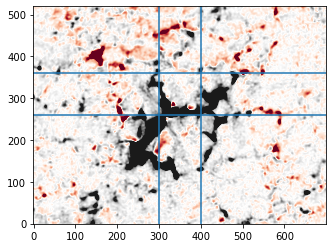

In [7]:
##------- Test display --------
plt.imshow(cube_mag_los[400:1100,600:1120,10].T, origin='lower', cmap='RdGy',vmax=70, vmin=-70)
plt.axvline(x=300)
plt.axvline(x=400)
plt.axhline(y=260)
plt.axhline(y=360)

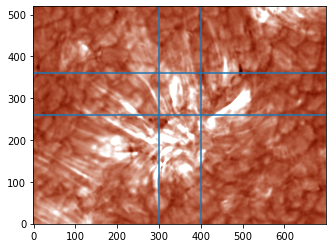

In [8]:
plt.imshow(cube_lc_widths[400:1100,600:1120,10].T, origin='lower', cmap='irissji1400',vmax=0.8)
plt.axvline(x=300)
plt.axvline(x=400)
plt.axhline(y=260)
plt.axhline(y=360)

# AIA light curves

In [9]:
I_light_211 = np.mean(np.mean(mgn_211[400+200:400+200+180,600+300:600+300+300,:],axis=0),axis=0)
I_light_193 = np.mean(np.mean(mgn_193[400+200:400+200+180,600+300:600+300+300,:],axis=0),axis=0)
I_light_171 = np.mean(np.mean(mgn_171[400+200:400+200+180,600+300:600+300+300,:],axis=0),axis=0)
I_light_304 = np.mean(np.mean(mgn_304[400+200:400+200+180,600+300:600+300+300,:],axis=0),axis=0)

In [10]:
#---- New FOV-- 

I_light_211_new = np.mean(np.mean(mgn_211[400+20:400+20+180,600+300:600+300+300,:],axis=0),axis=0)
I_light_193_new = np.mean(np.mean(mgn_193[400+20:400+20+180,600+300:600+300+300,:],axis=0),axis=0)
I_light_171_new = np.mean(np.mean(mgn_171[400+20:400+20+180,600+300:600+300+300,:],axis=0),axis=0)
I_light_304_new = np.mean(np.mean(mgn_304[400+20:400+20+180,600+300:600+300+300,:],axis=0),axis=0)

In [11]:
#--- Intermediate FOV------
I_light_211_int = np.mean(np.mean(mgn_211[400+110:400+110+180,600+300:600+300+200,:],axis=0),axis=0)
I_light_193_int = np.mean(np.mean(mgn_193[400+110:400+110+180,600+300:600+300+200,:],axis=0),axis=0)
I_light_171_int = np.mean(np.mean(mgn_171[400+110:400+110+180,600+300:600+300+200,:],axis=0),axis=0)
I_light_304_int = np.mean(np.mean(mgn_304[400+110:400+110+180,600+300:600+300+200,:],axis=0),axis=0)

Text(0.5, 1.0, 'Leftmost FOV')

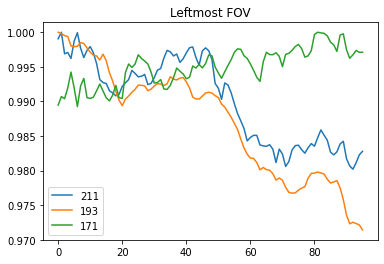

In [12]:
plt.plot(I_light_211_new/np.max(I_light_211_new), label='211')
plt.plot(I_light_193_new/np.max(I_light_193_new), label='193')
plt.plot(I_light_171_new/np.max(I_light_171_new), label='171')
plt.legend()
plt.title('Leftmost FOV')

Text(0.5, 1.0, 'Rightmost FOV')

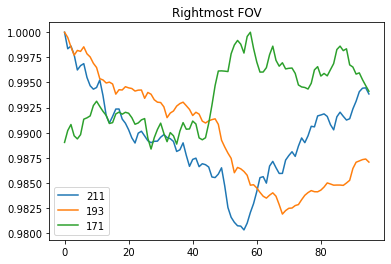

In [13]:
plt.plot(I_light_211/np.max(I_light_211), label='211')
plt.plot(I_light_193/np.max(I_light_193), label='193')
plt.plot(I_light_171/np.max(I_light_171), label='171')
#plt.plot(I_light_304/np.max(I_light_304), label='304')
plt.legend()
plt.title('Rightmost FOV')
#plt.yscale('log')

Text(0.5, 1.0, 'Intermediate FOV')

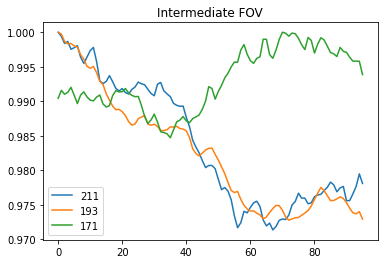

In [14]:
plt.plot(I_light_211_int/np.max(I_light_211_int), label='211')
plt.plot(I_light_193_int/np.max(I_light_193_int), label='193')
plt.plot(I_light_171_int/np.max(I_light_171_int), label='171')
#plt.plot(I_light_304_int/np.max(I_light_304_int), label='304')
plt.legend()
plt.title('Intermediate FOV')

# H$\beta$ light curve analysis

In [15]:
I_lc_Hbeta = np.mean(np.mean(cube_lc_widths[400+300:400+300+100,600+260:600+260+100,:],axis=0),axis=0)

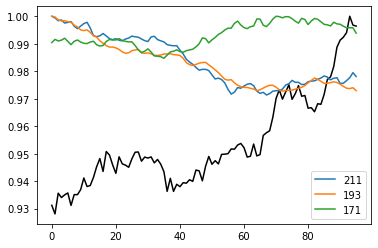

In [17]:
plt.plot(I_lc_Hbeta/np.max(I_lc_Hbeta), color='black')
#plt.axvline(x=np.where(I_lc_Hbeta == np.min(I_lc_Hbeta)))
plt.plot(I_light_211_int/np.max(I_light_211_int), label='211')
plt.plot(I_light_193_int/np.max(I_light_193_int), label='193')
plt.plot(1.00*I_light_171_int/np.max(I_light_171_int), label='171')
#plt.plot(I_light_304/np.max(I_light_304), label='304')
plt.legend()
#plt.yscale('log')

In [18]:
neg_mag=np.zeros(96)
pos_mag = neg_mag*0
#cancled_mag = neg_mag*0
for time in tqdm(range(96)):
    test_mag = cube_mag_los[400+300:400+300+100,600+250:600+250+100,time]
    mask = test_mag*0
    mask[np.where(test_mag <= -20)]=1.
    neg_mag[time] = np.sum(np.abs(test_mag*mask))*100*100*0.0379*722*1e5*0.0379*722*1e5  # Converting to Mx; 1 Mx = 1 Gcm^2
    pos_mag[time] = np.sum(np.abs(test_mag*(1-mask)))*100*100*0.0379*722*1e5*0.0379*722*1e5
    
    #neg_mag[time] = np.min(test_mag[np.where(test_mag<-20)])
    

100%|██████████| 96/96 [00:00<00:00, 4729.64it/s]


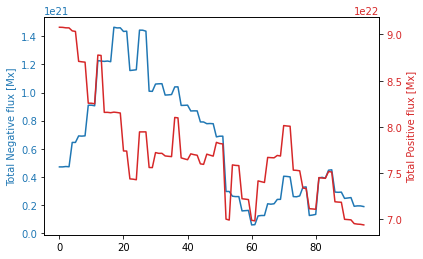

In [19]:
fig,ax= plt.subplots()
color = 'tab:blue'
ax.set_ylabel(r'Total Negative flux [Mx]',color=color)
#ax.set_xlabel(r'$\lambda$[nm]')
ax.plot(neg_mag,color=color)
ax.tick_params(axis='y', labelcolor=color)

ax2=ax.twinx()
color ='tab:red'
ax2.set_ylabel(r'Total Positive flux [Mx]',color=color)
ax2.plot(pos_mag,color=color)
ax2.tick_params(axis='y', labelcolor=color)

# plt.plot(neg_mag, label='-ve')
# plt.plot(pos_mag, label='+ve')
# plt.legend()
# plt.yscale('log')

In [21]:
##---- Reading the time array from SST data

time_str = times*0
for time in range(96):
    b = times[time][0:8]
    time_str[time]= b.decode('utf-8')

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


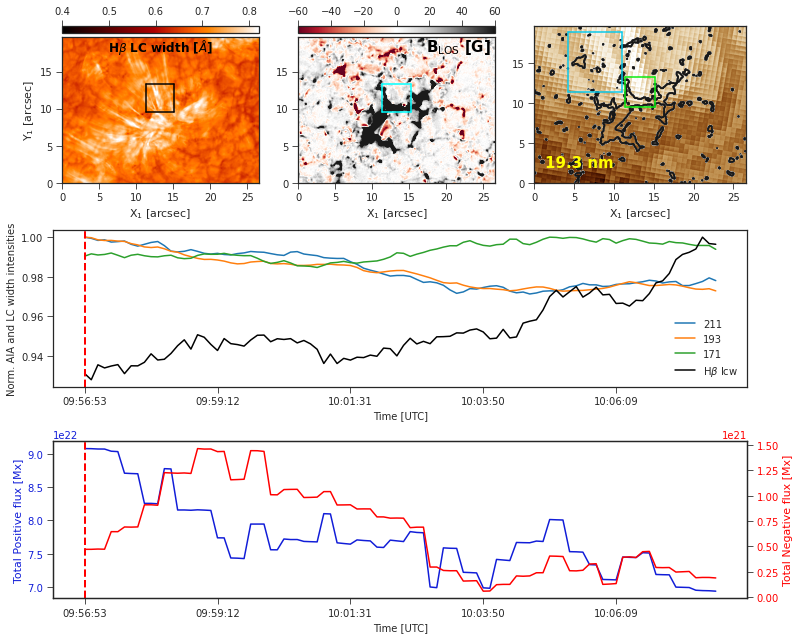

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


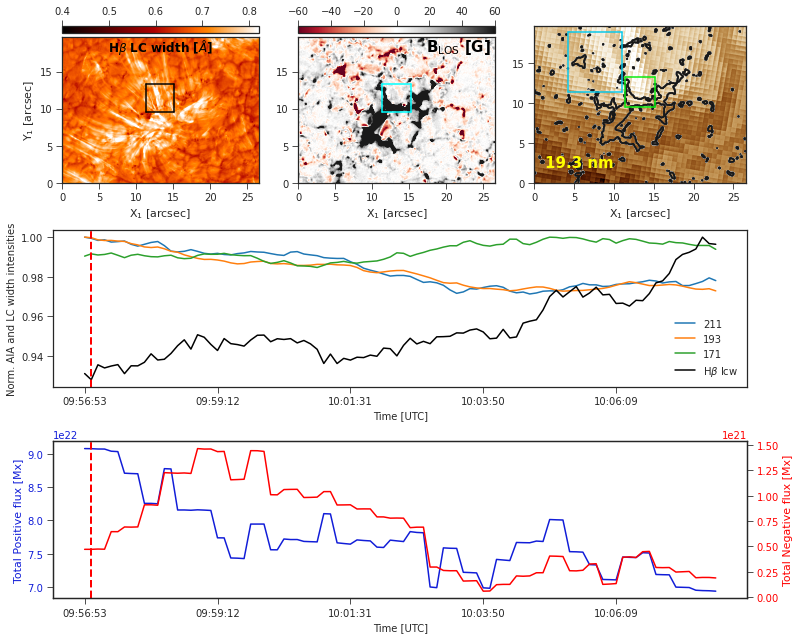

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


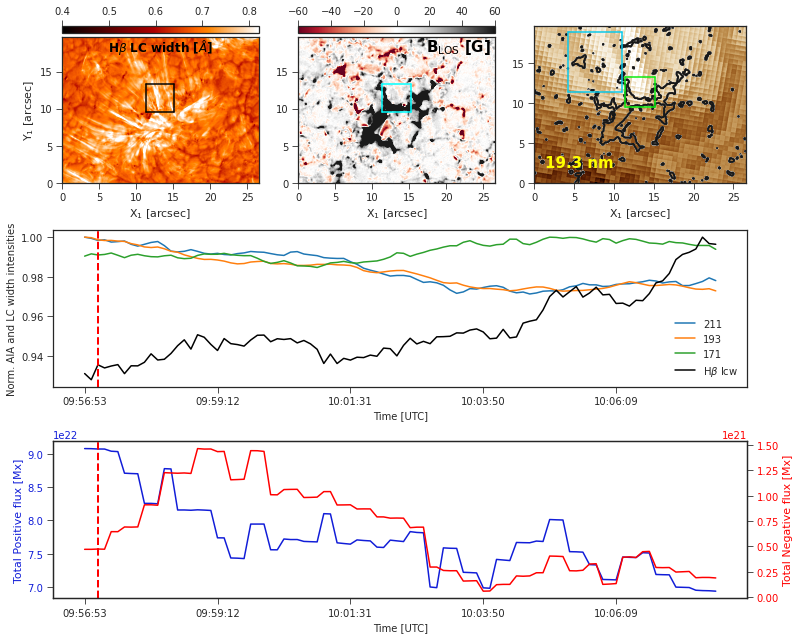

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


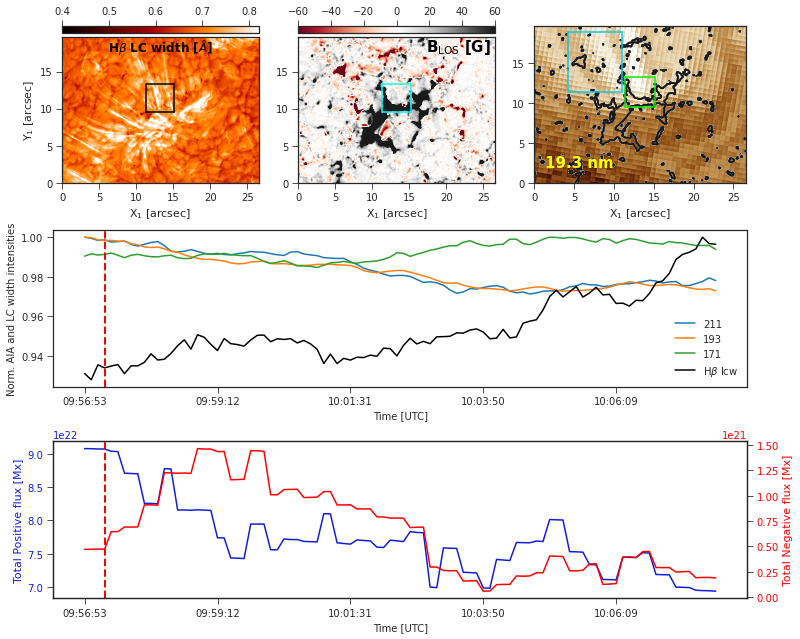

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


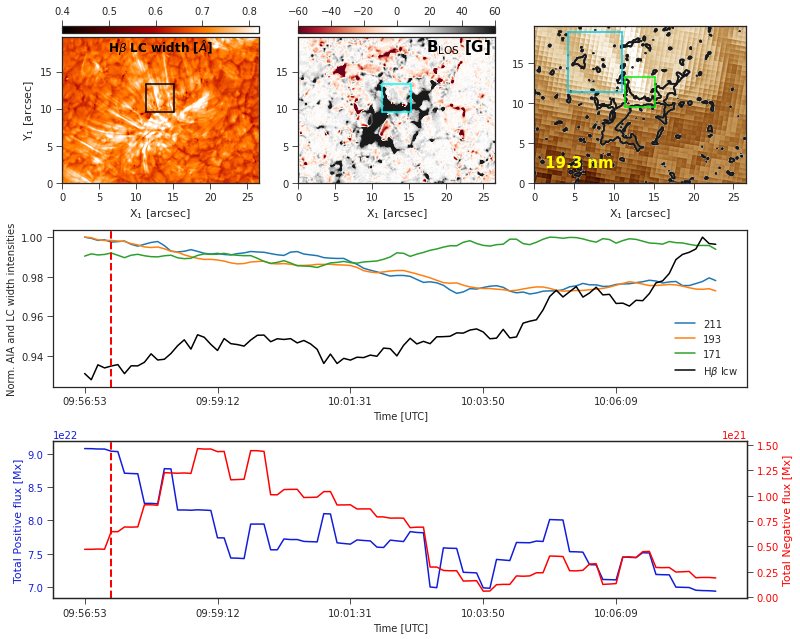

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


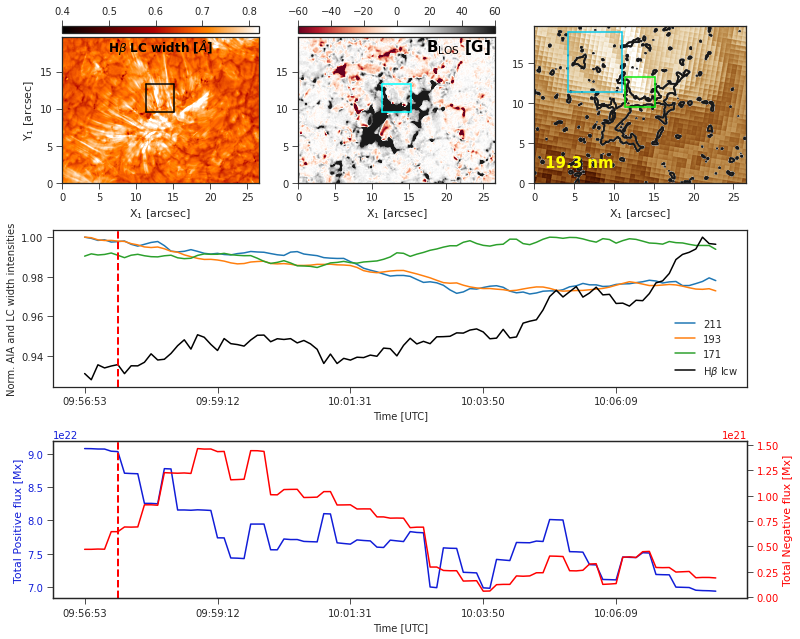

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


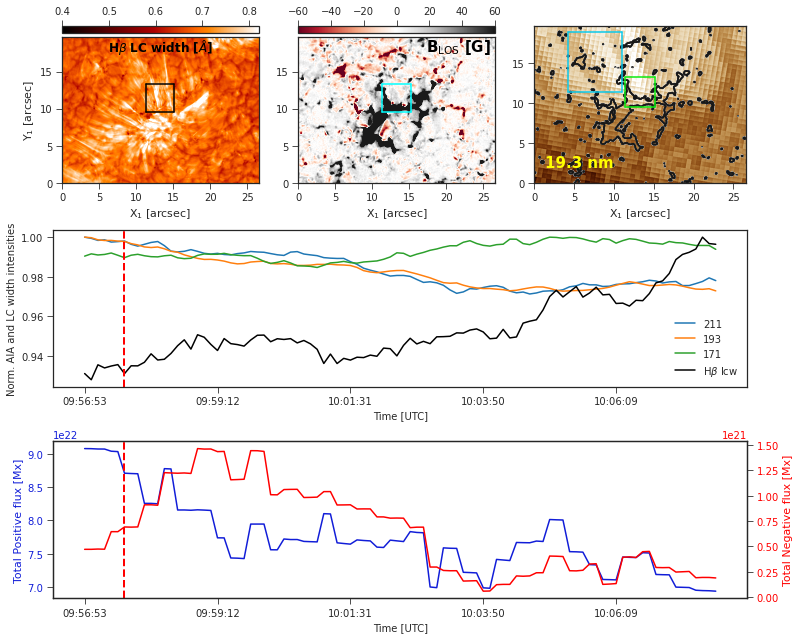

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


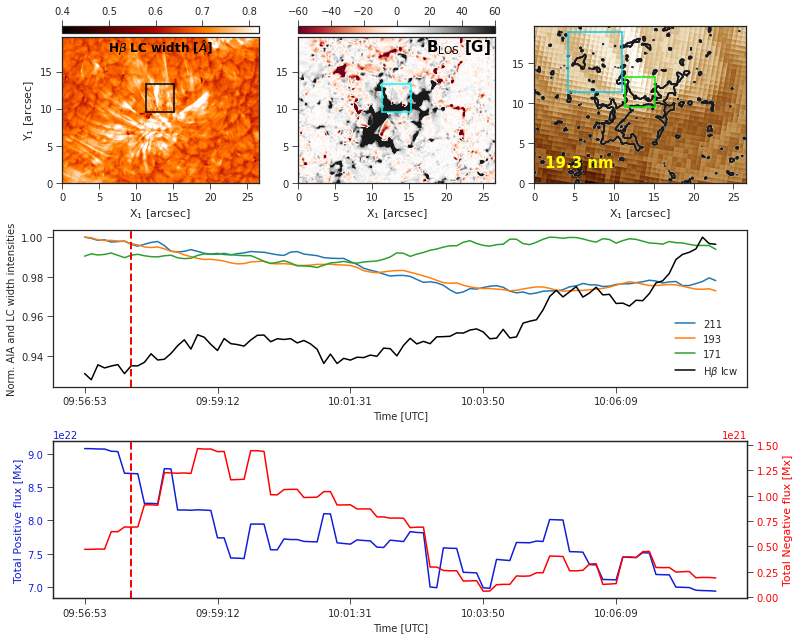

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


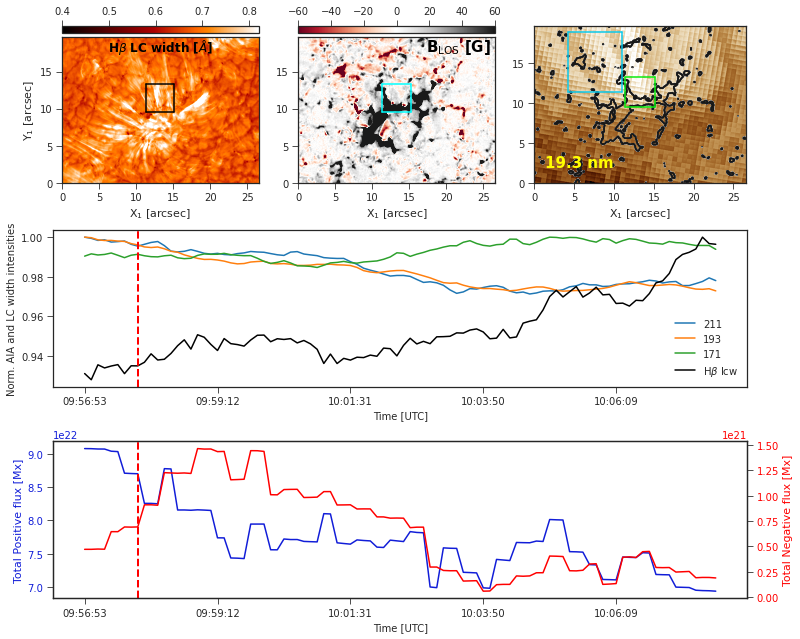

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


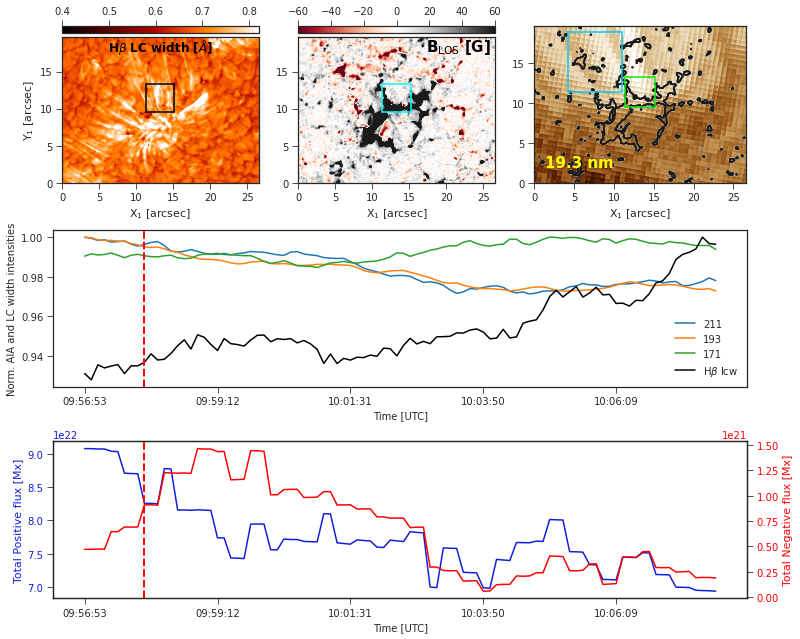

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


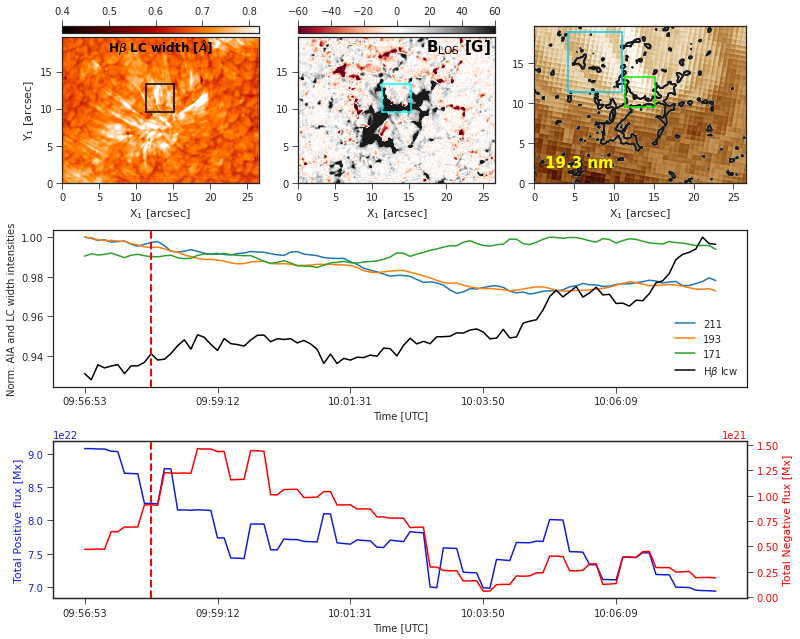

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


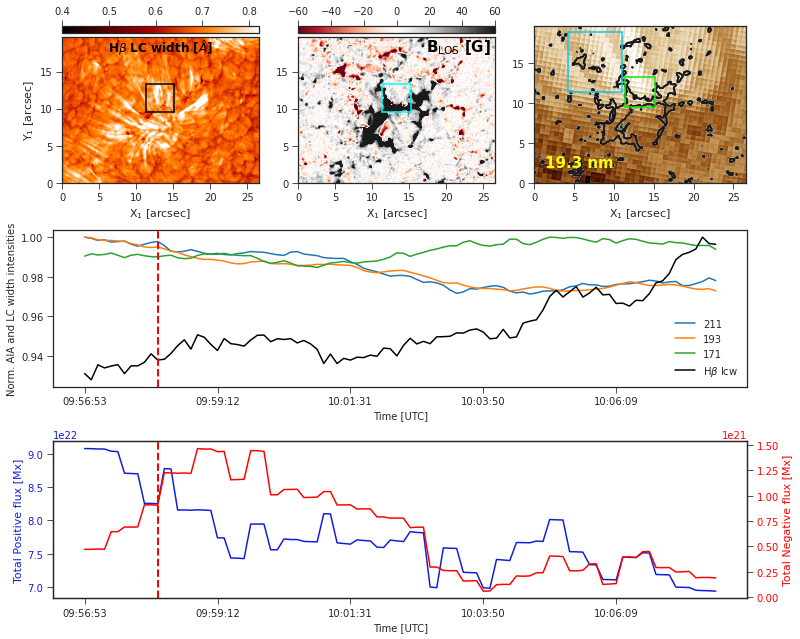

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


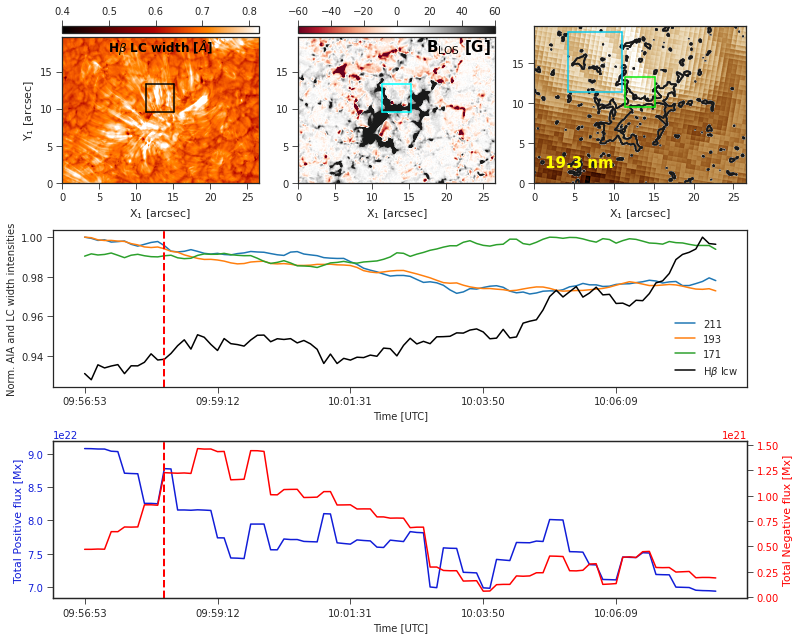

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


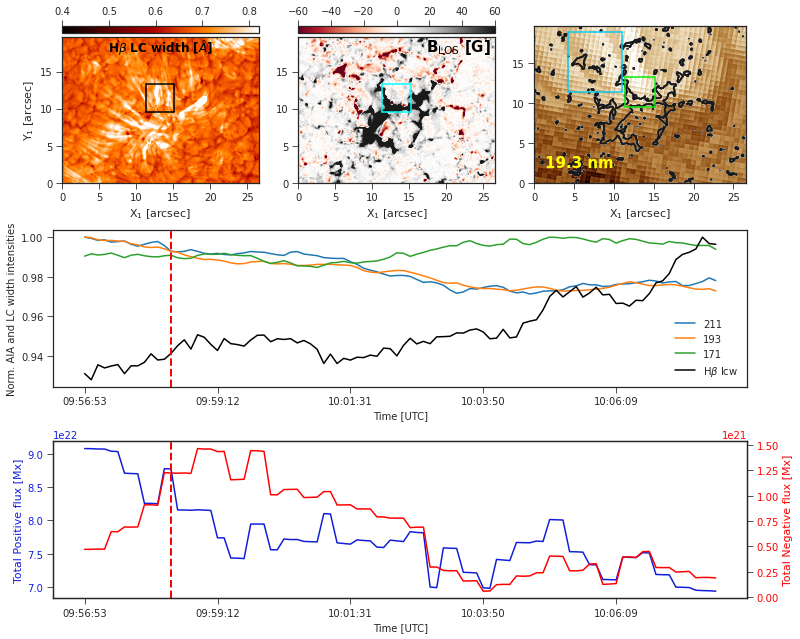

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


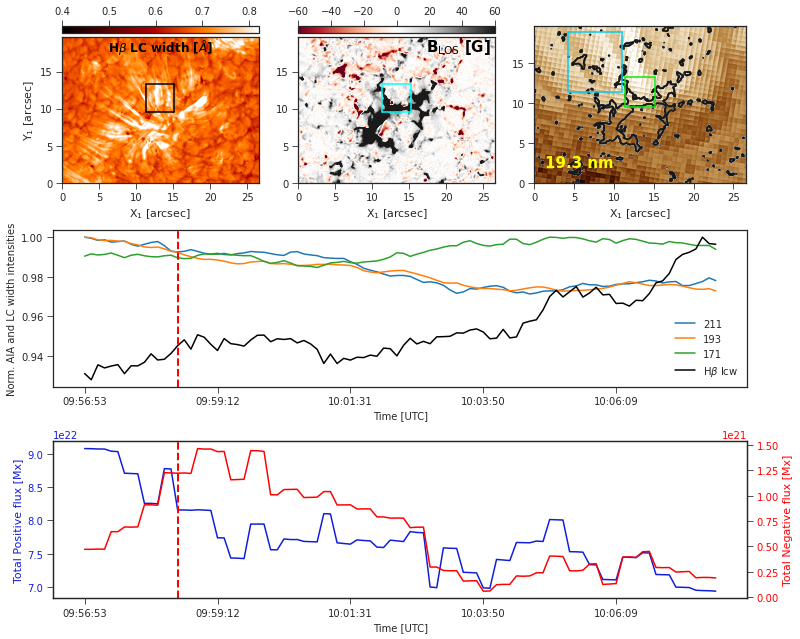

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


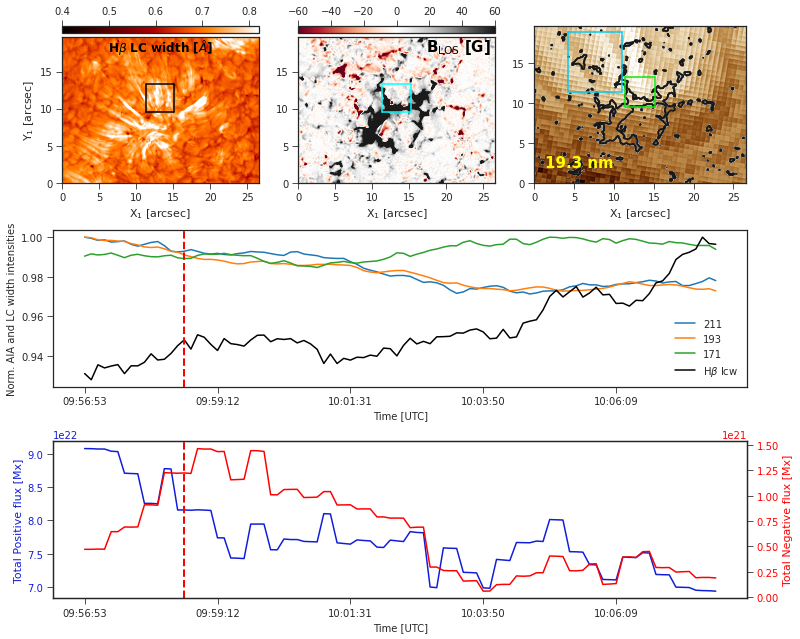

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


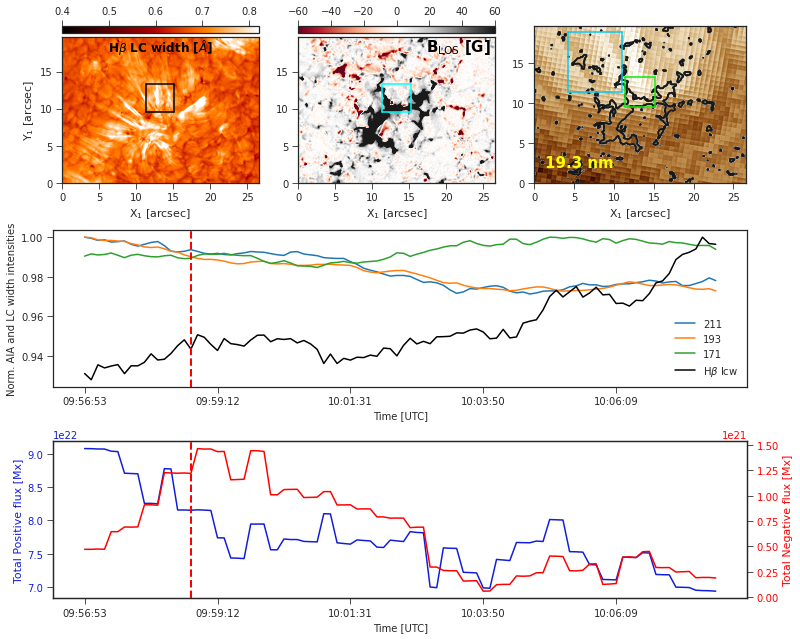

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


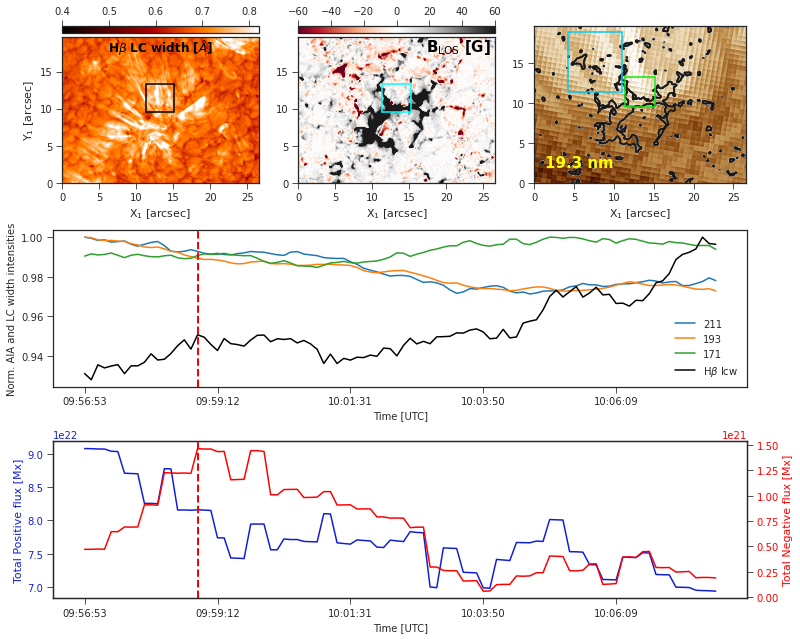

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


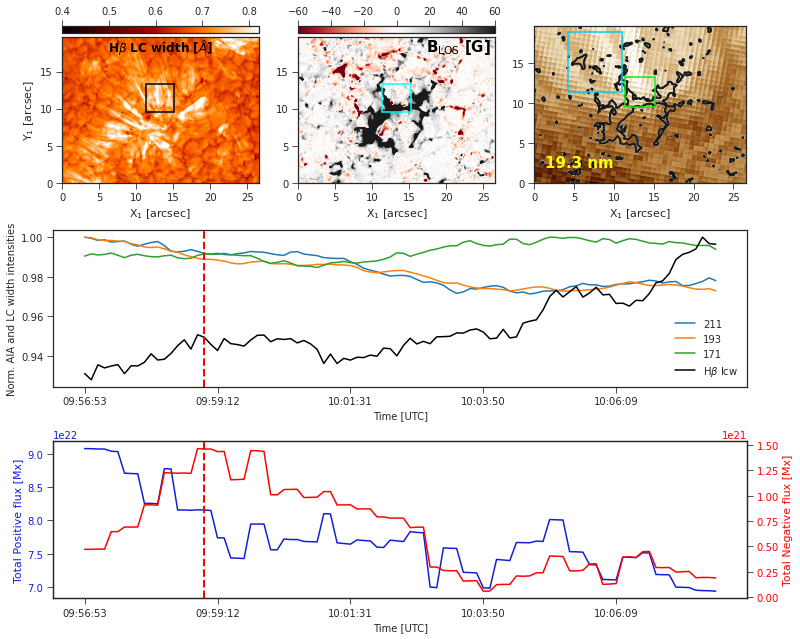

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


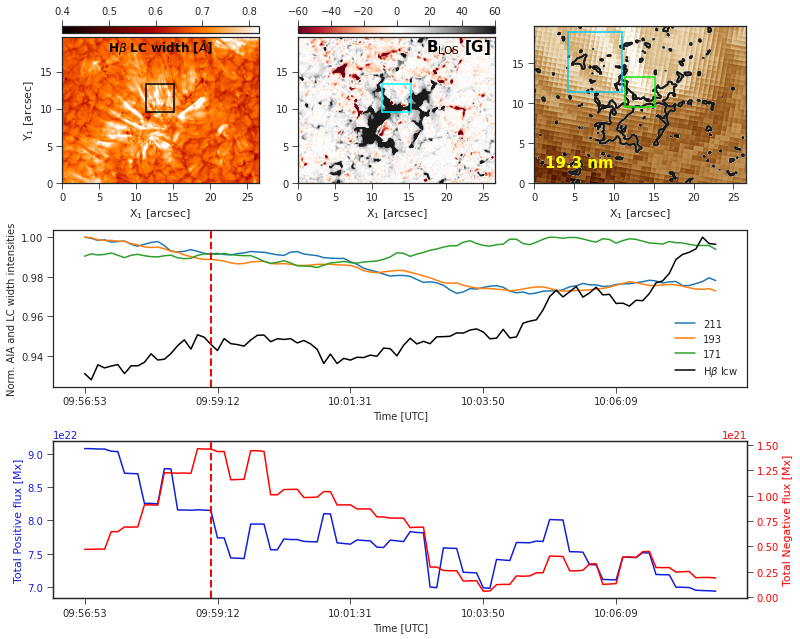

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


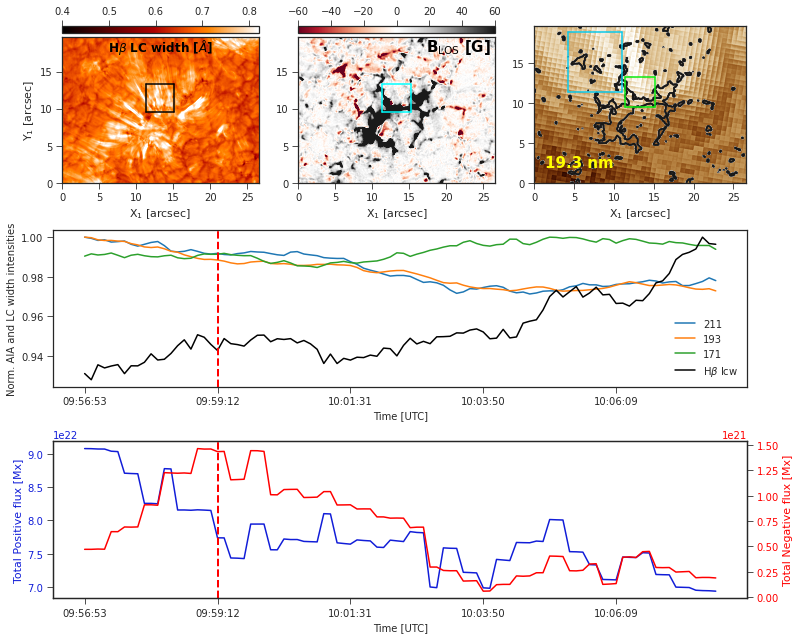

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


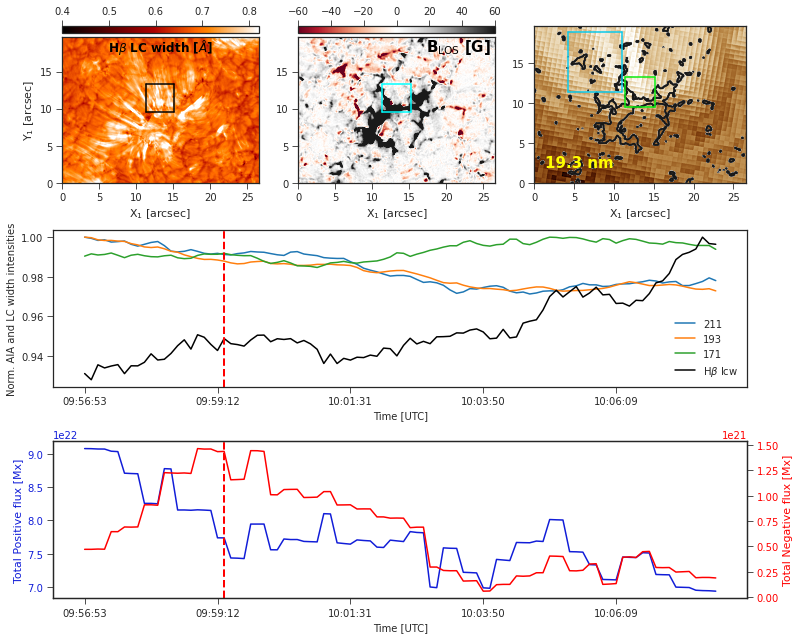

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


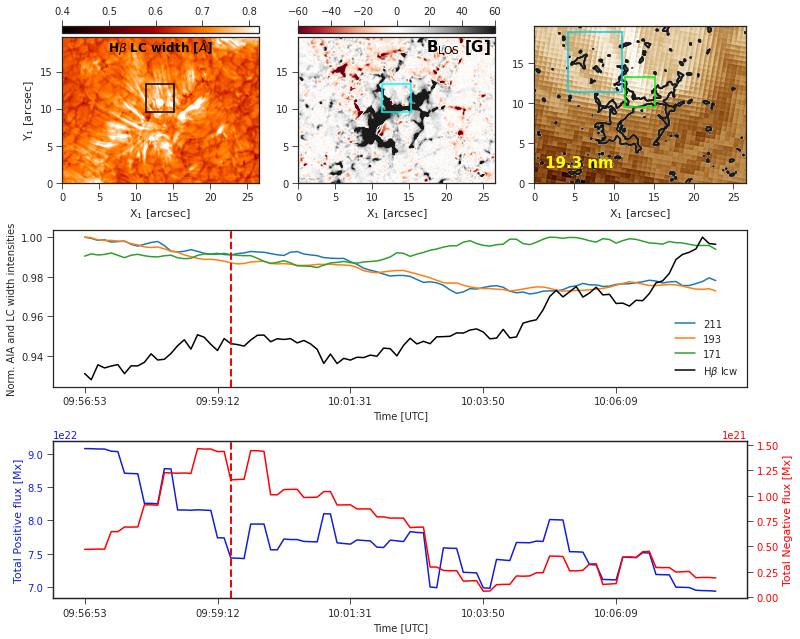

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


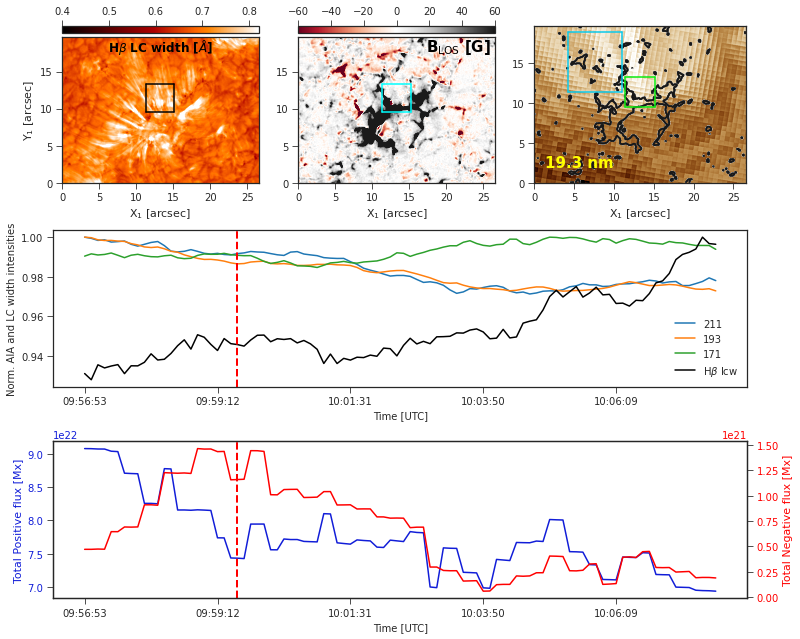

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


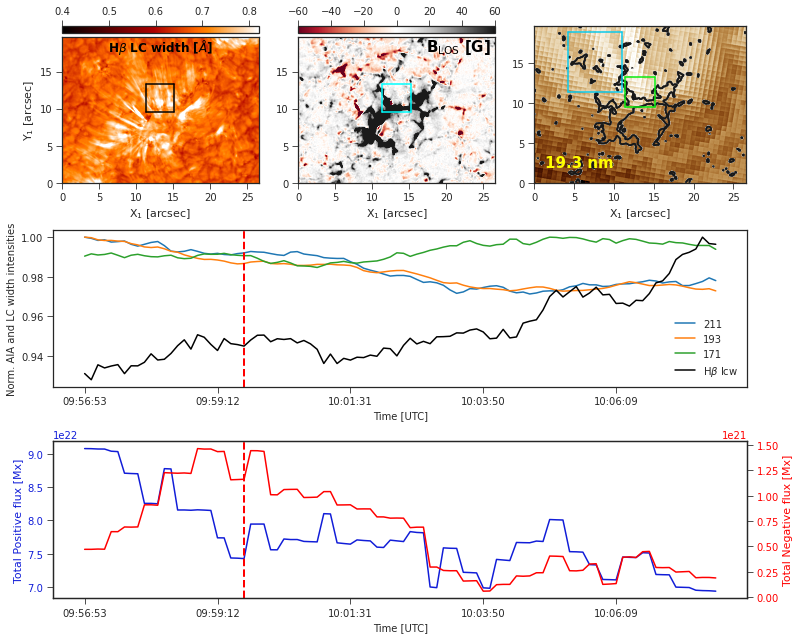

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


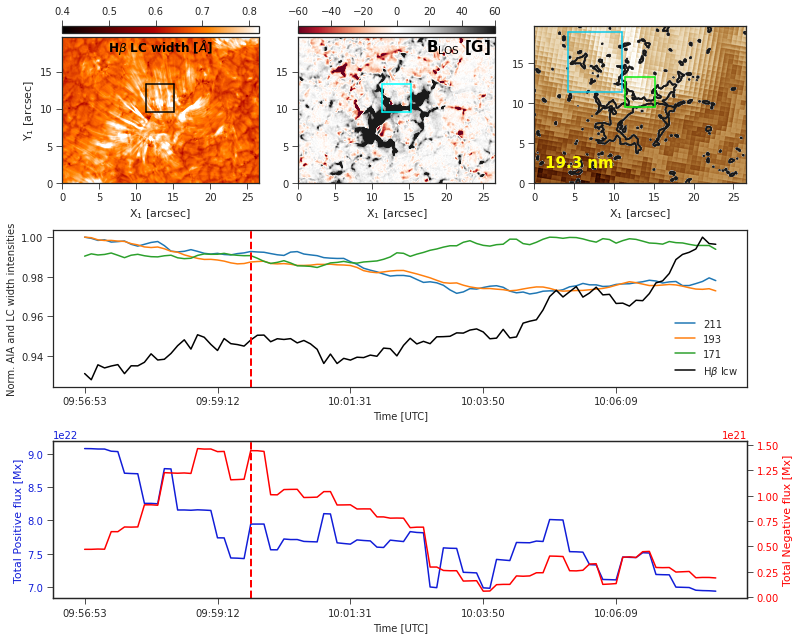

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


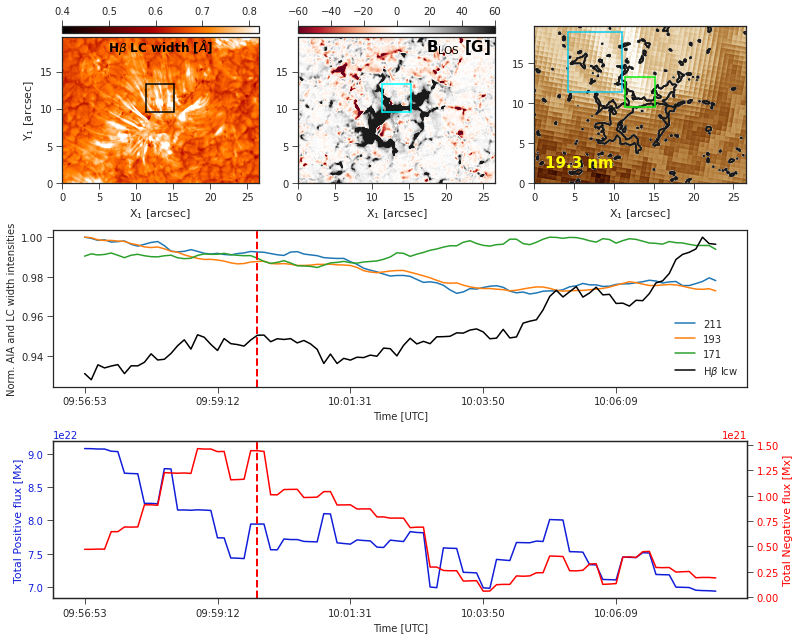

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


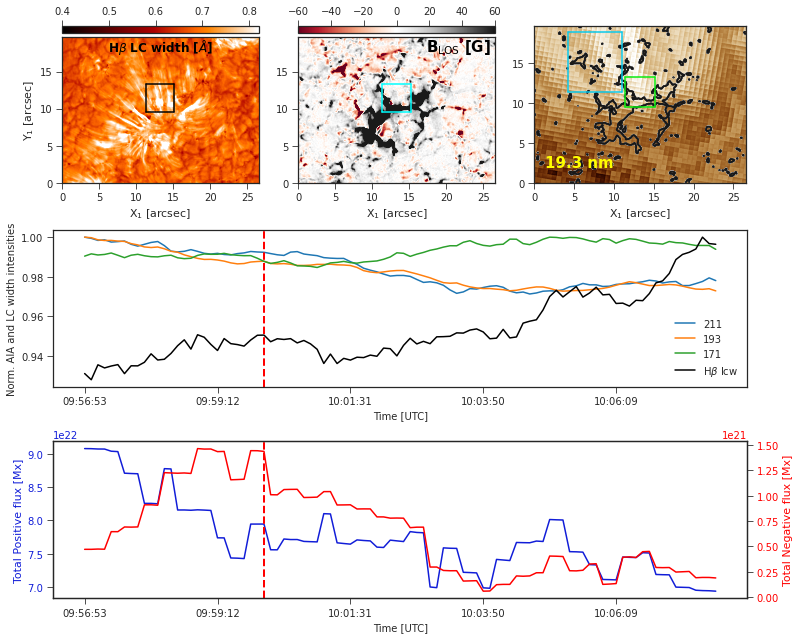

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


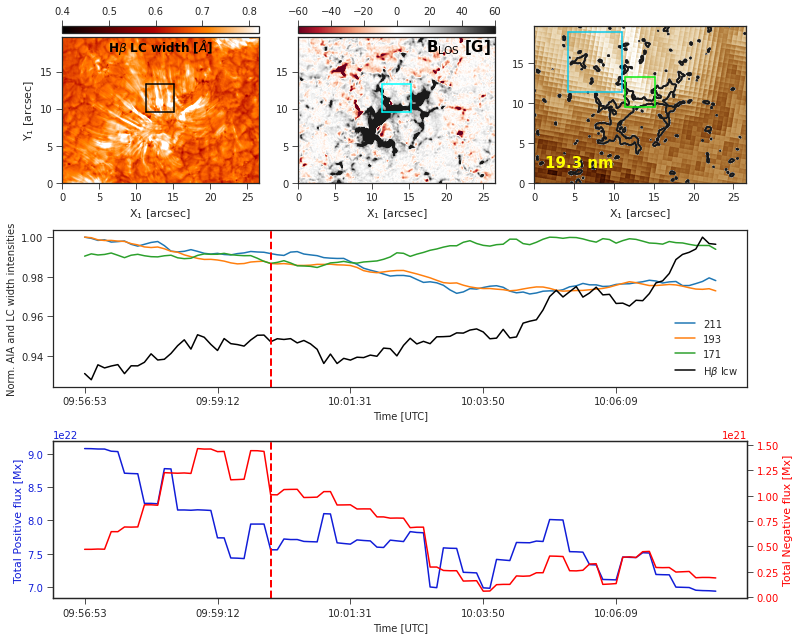

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


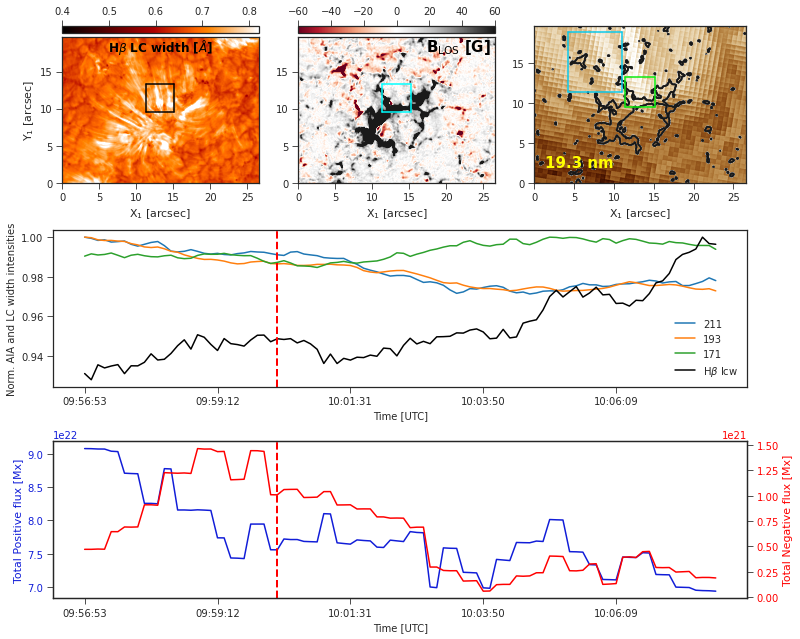

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


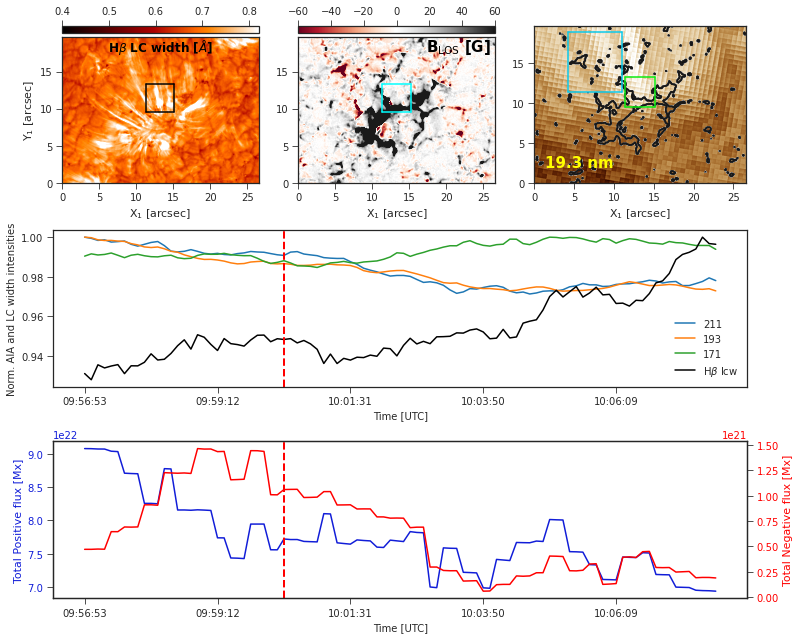

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


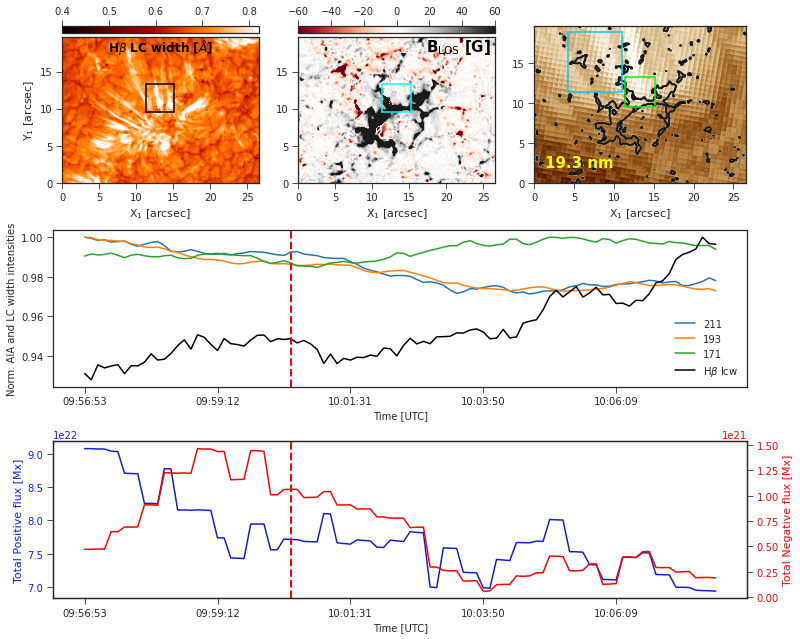

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


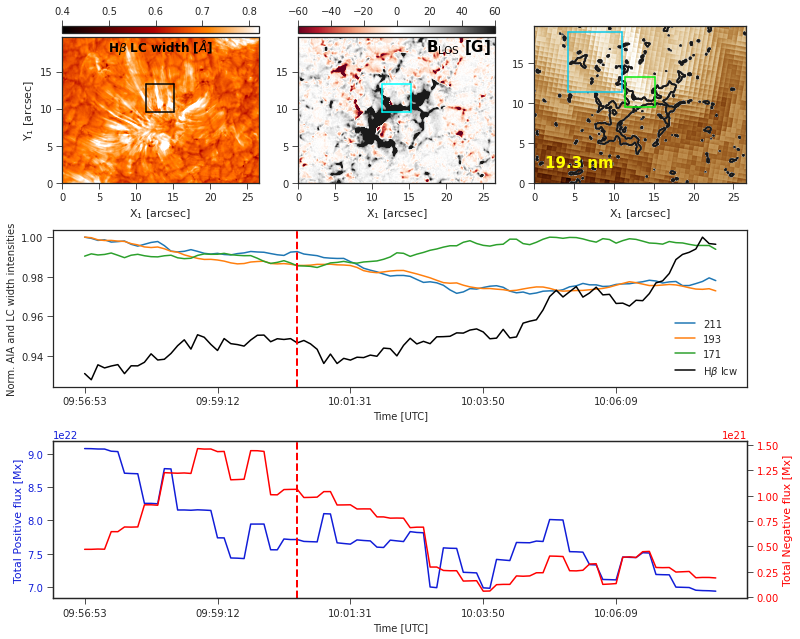

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


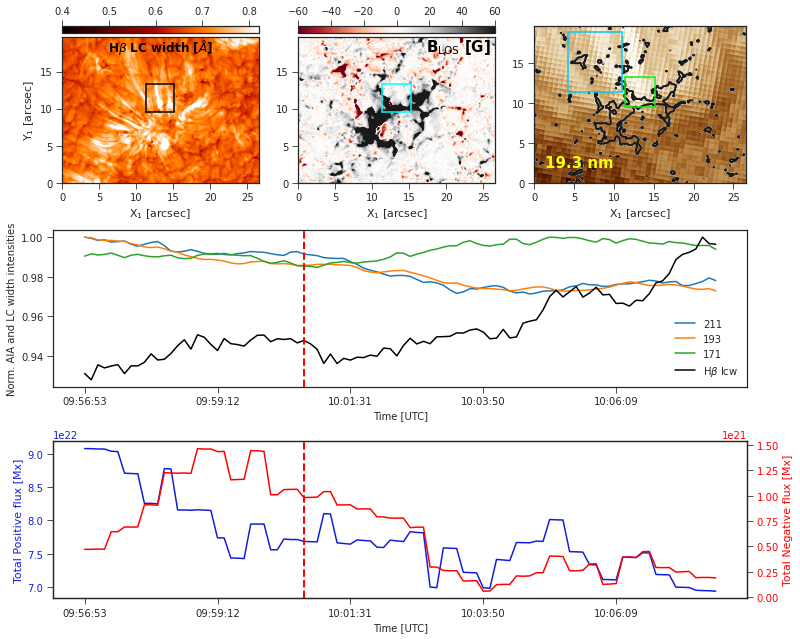

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


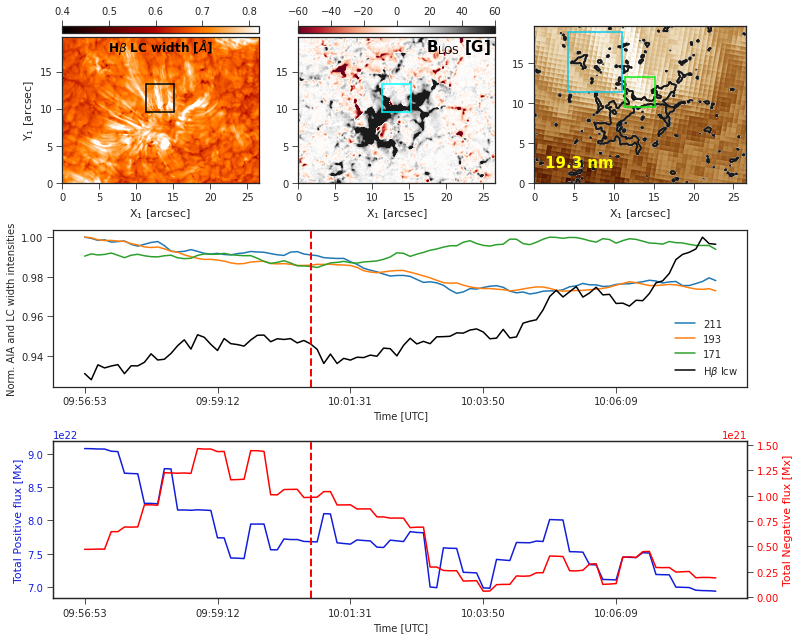

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


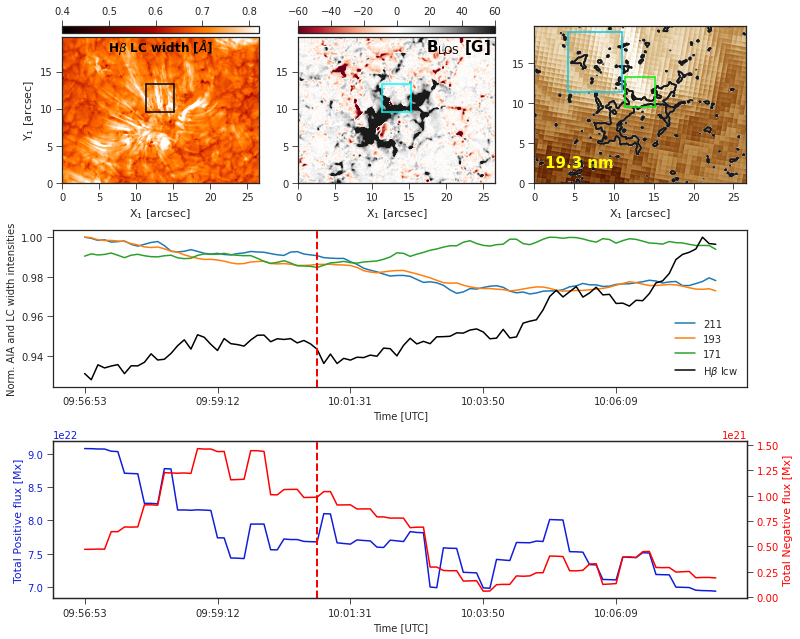

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


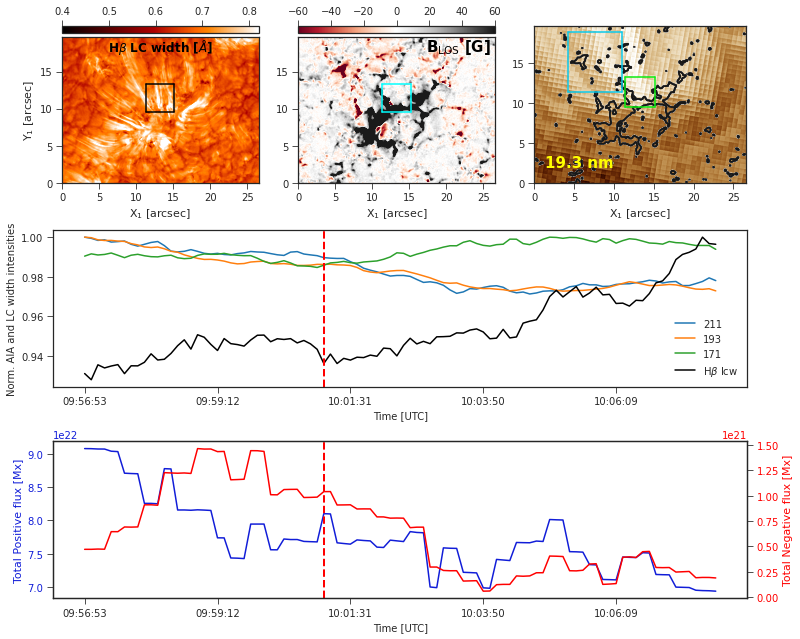

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


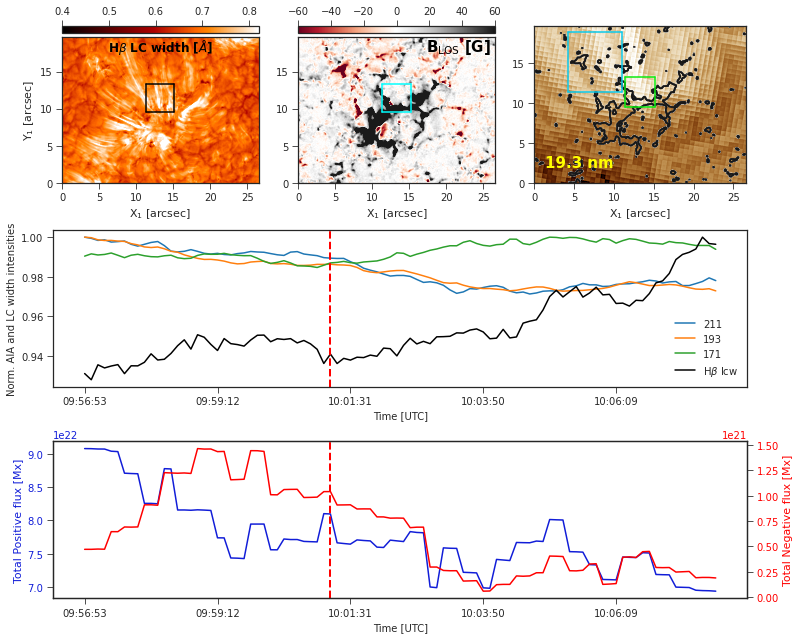

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


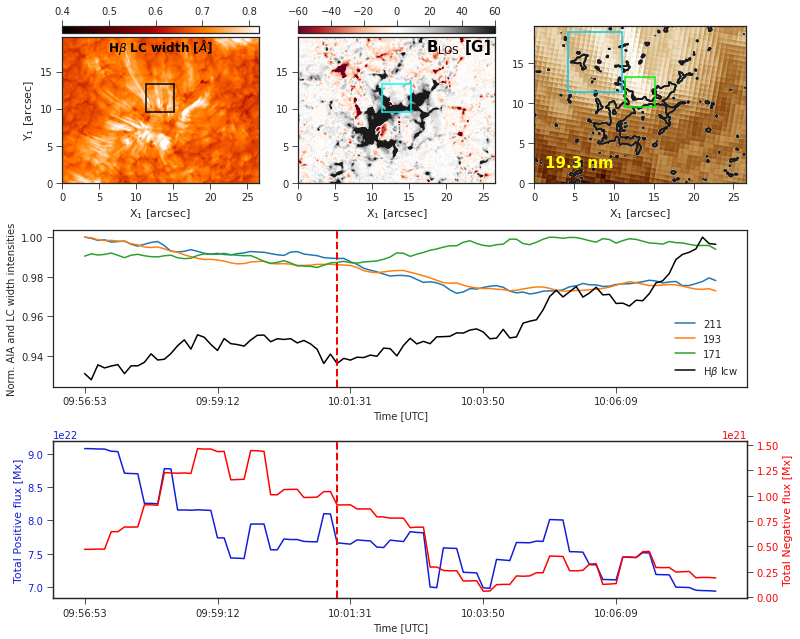

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


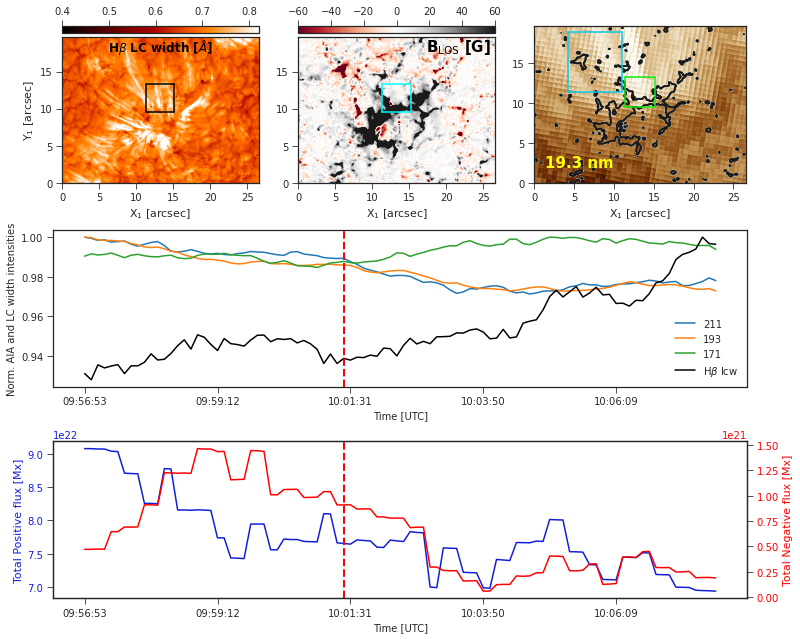

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


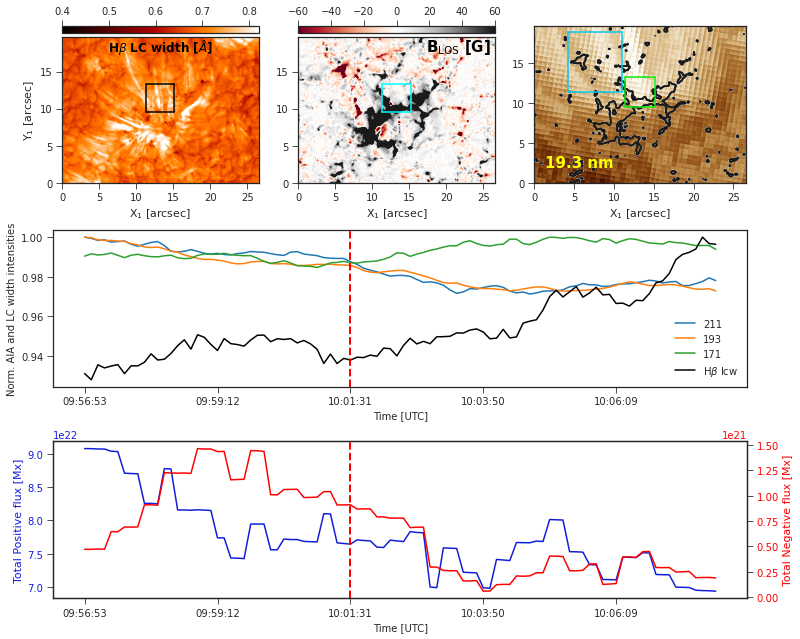

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


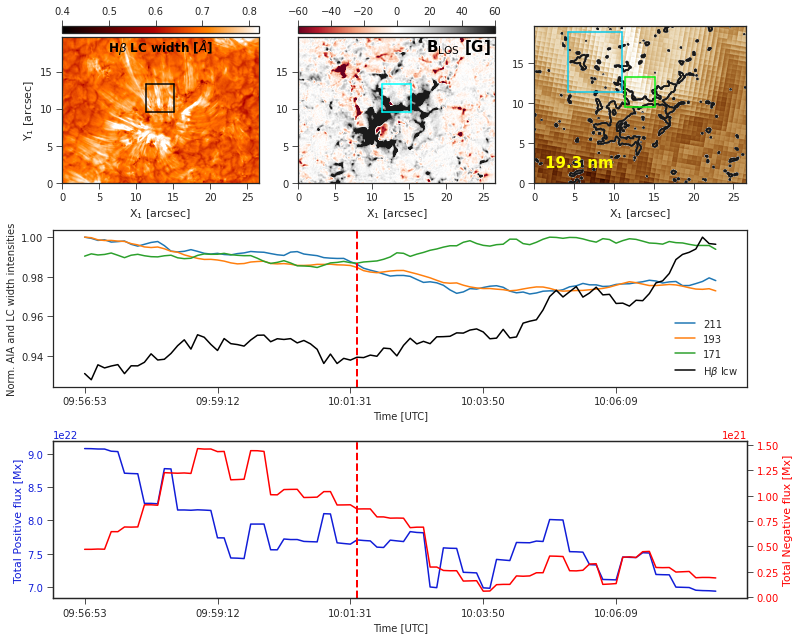

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


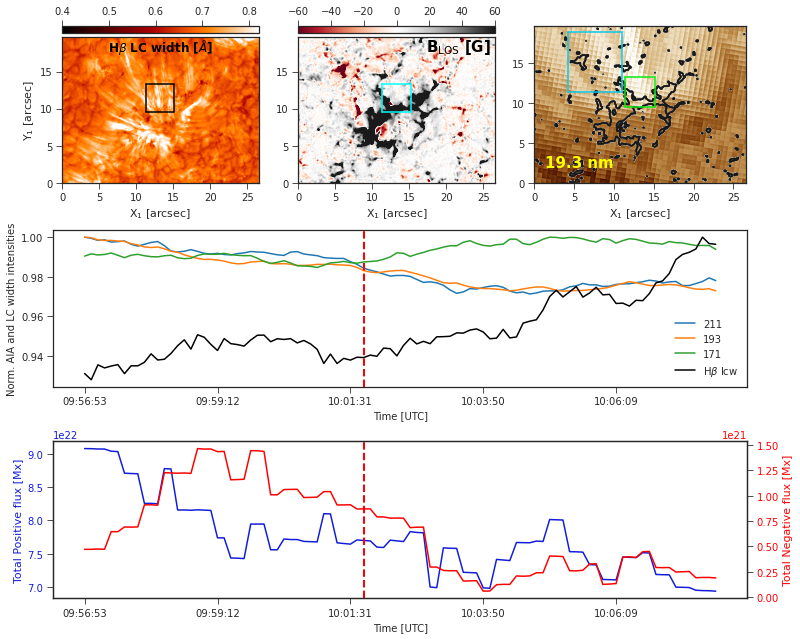

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


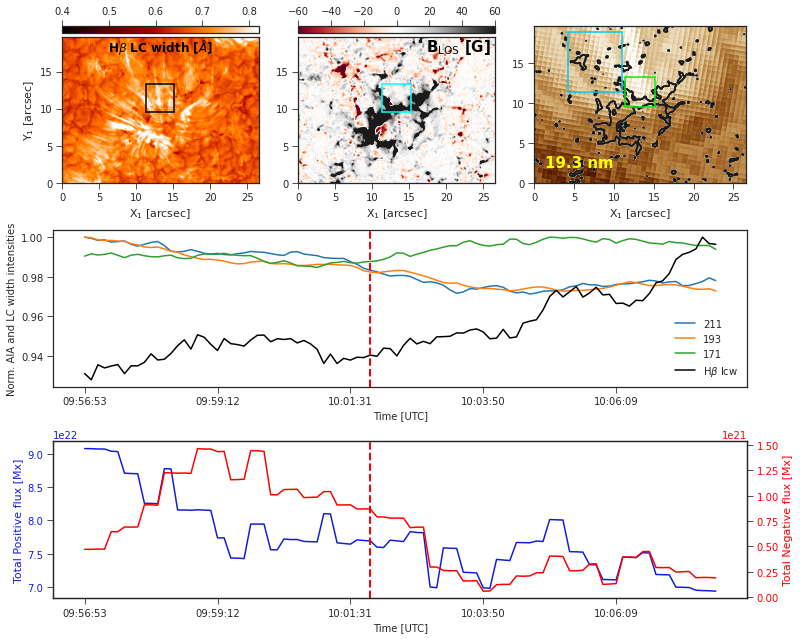

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


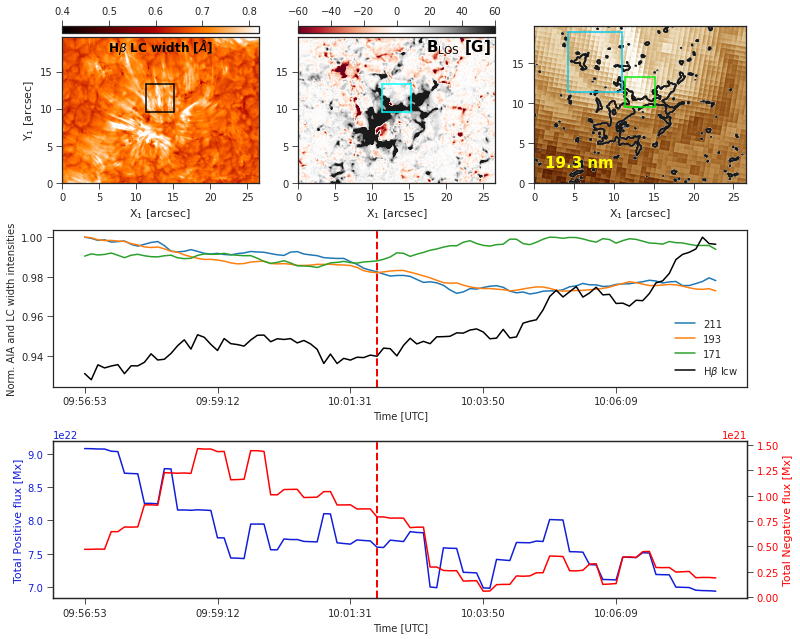

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


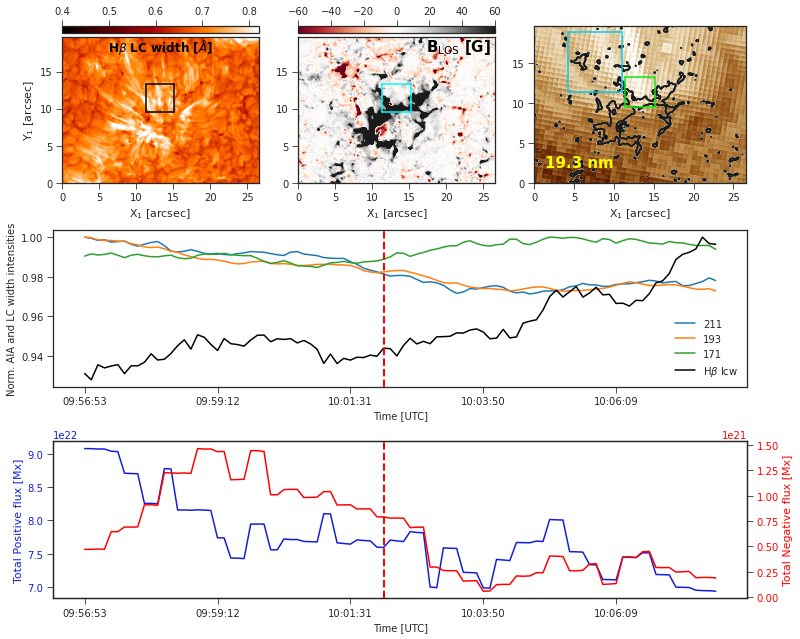

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


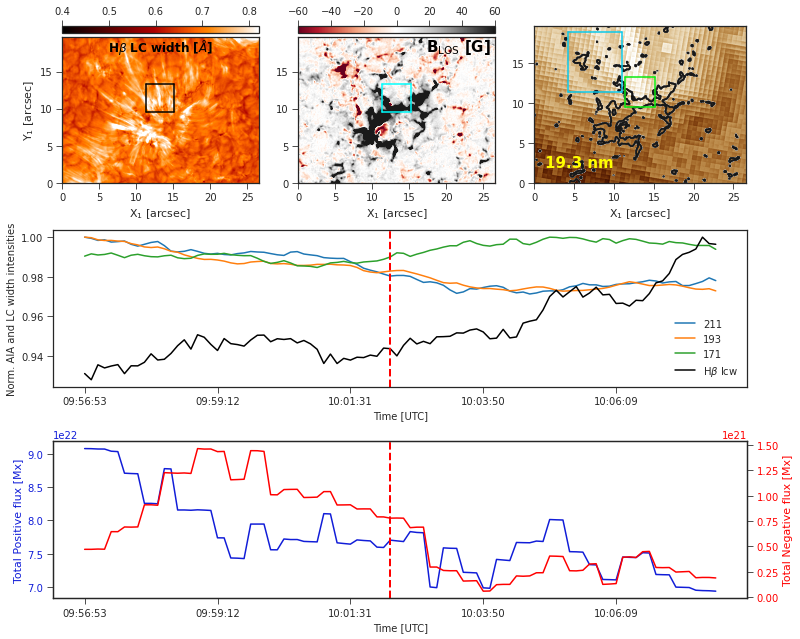

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


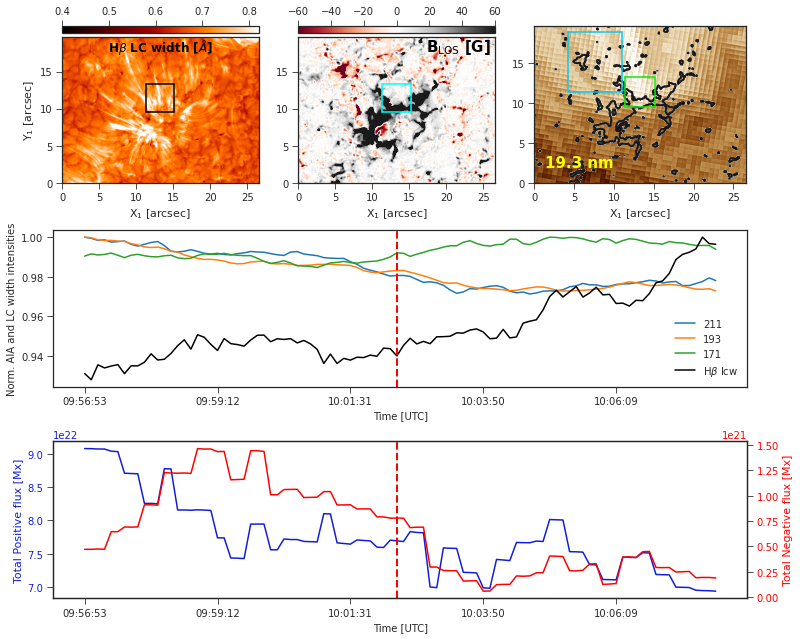

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


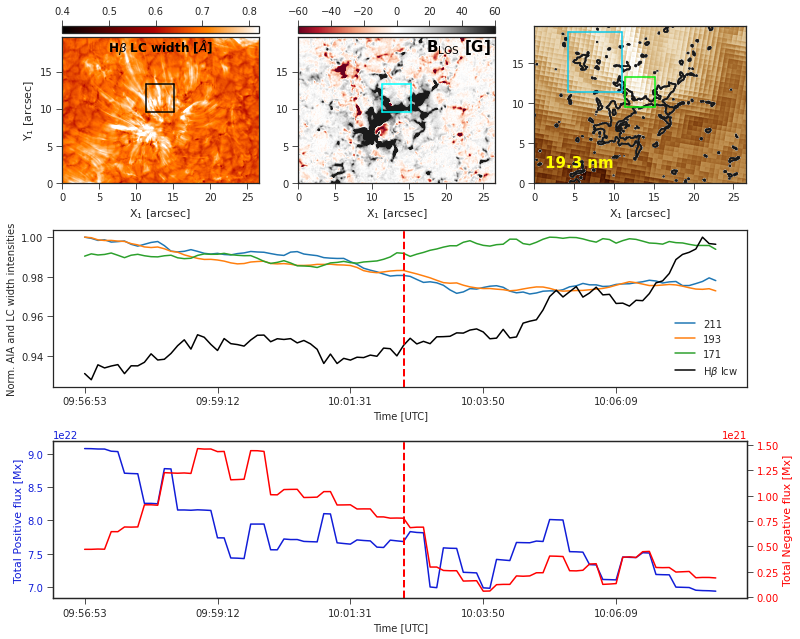

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


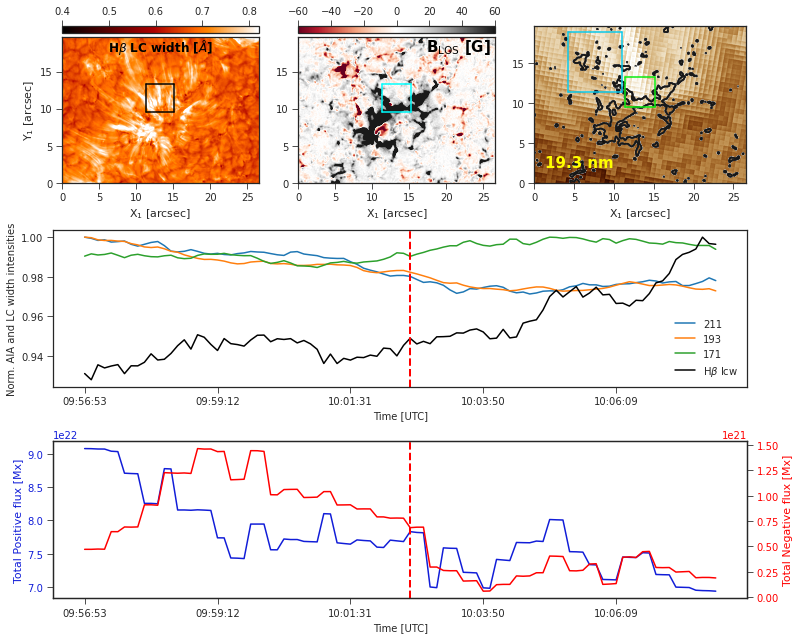

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


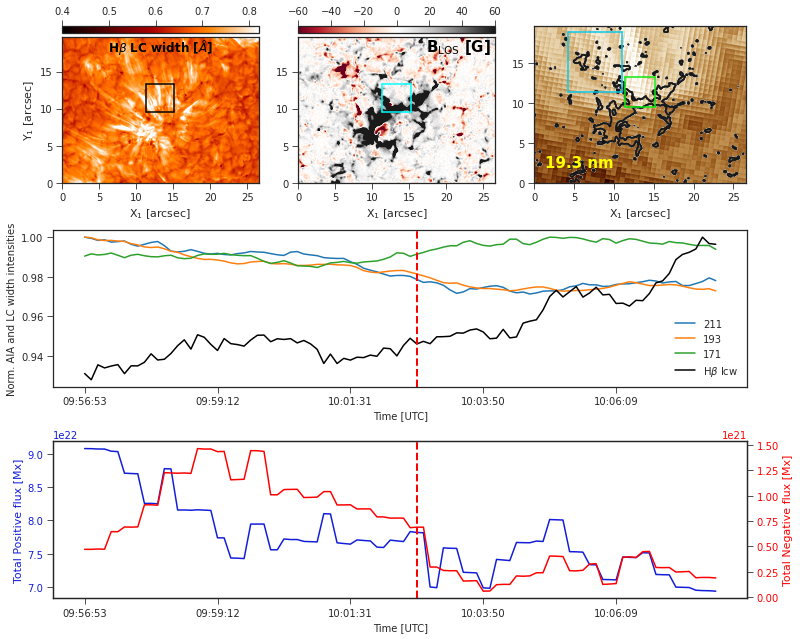

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


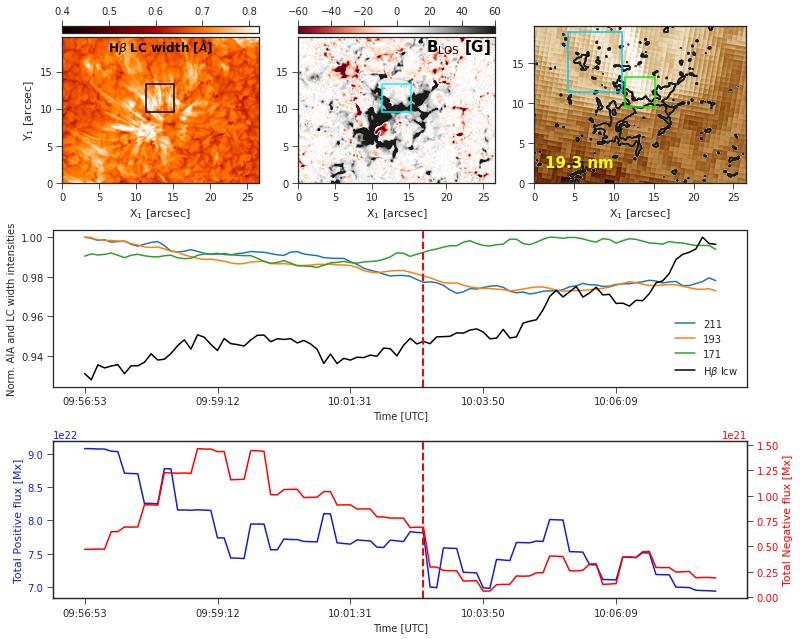

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


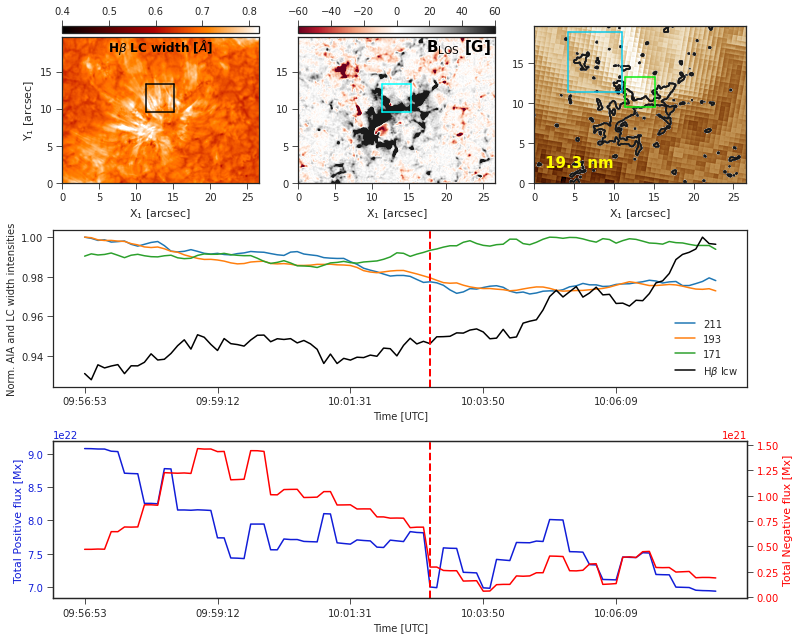

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


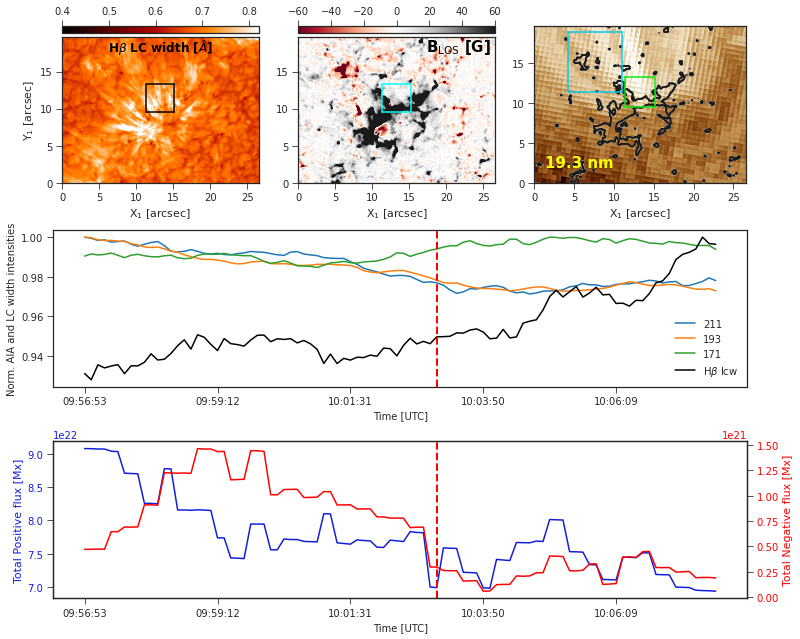

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


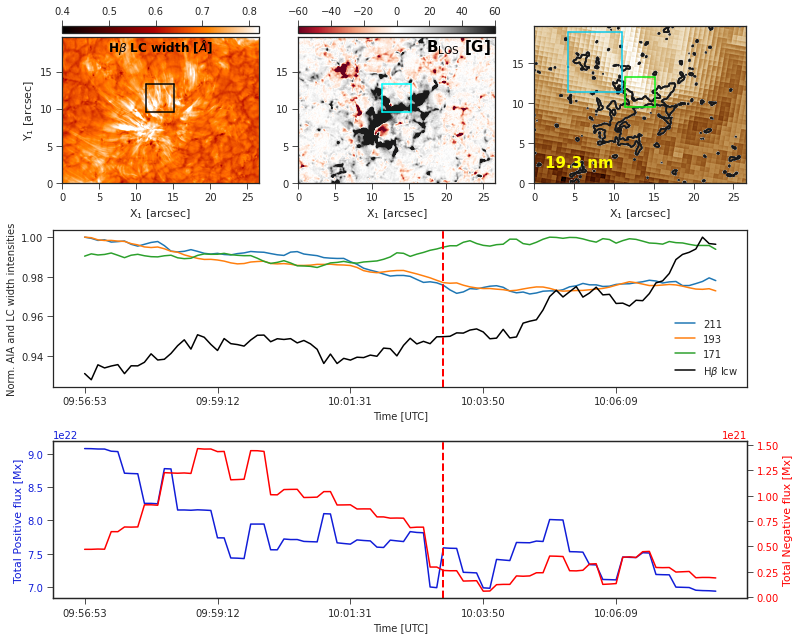

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


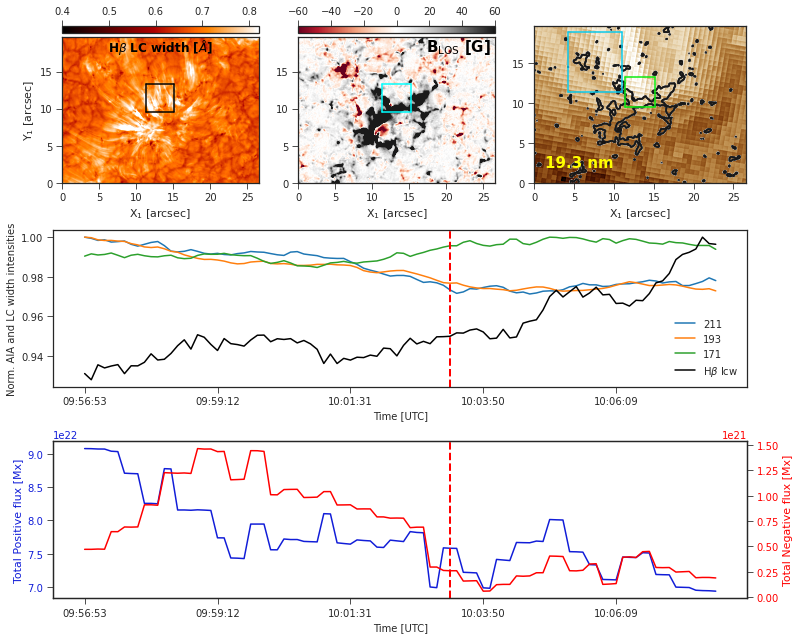

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


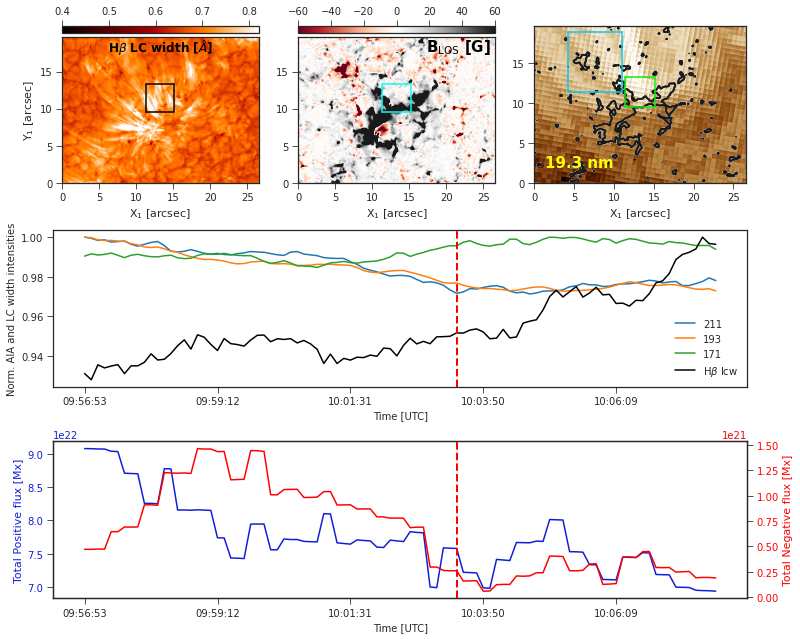

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


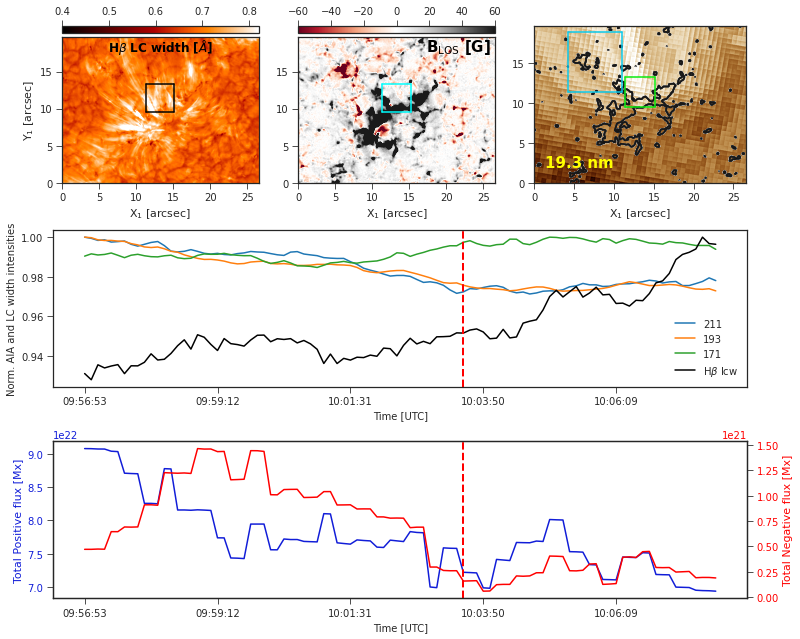

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


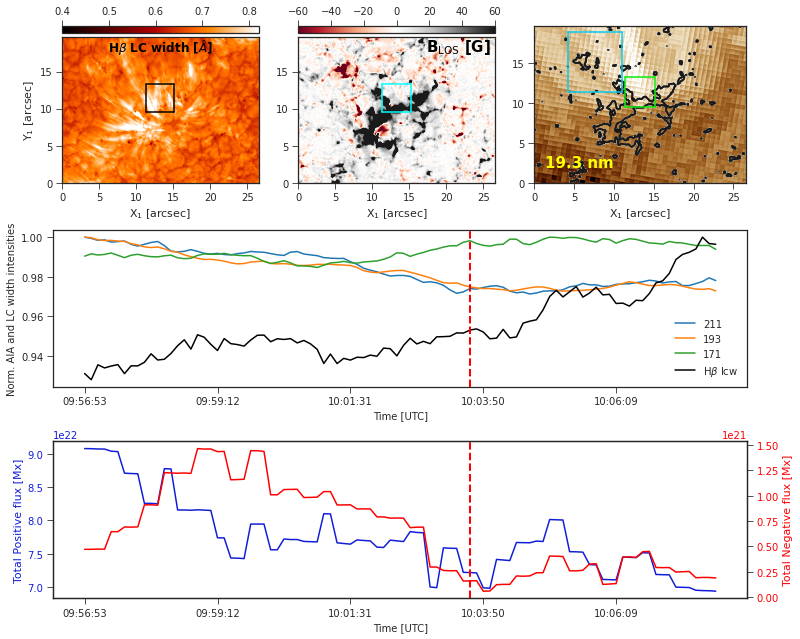

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


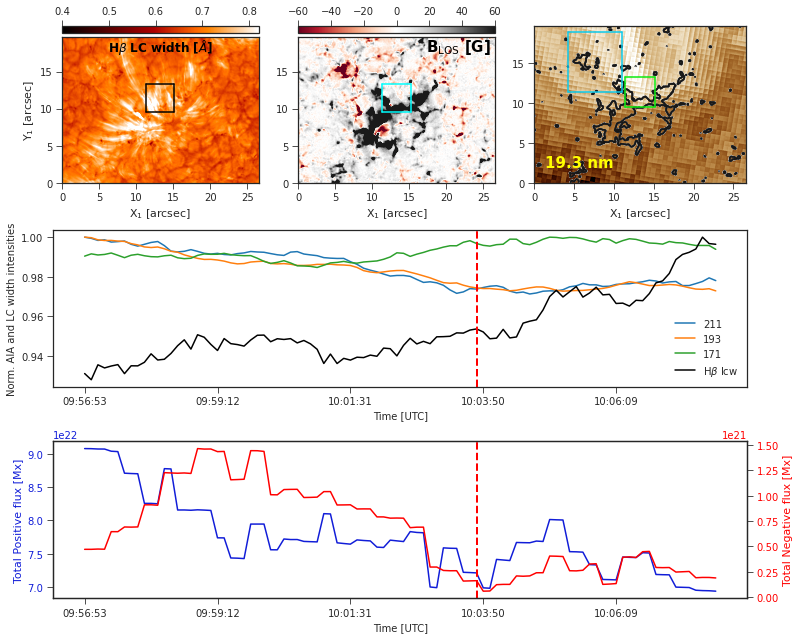

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


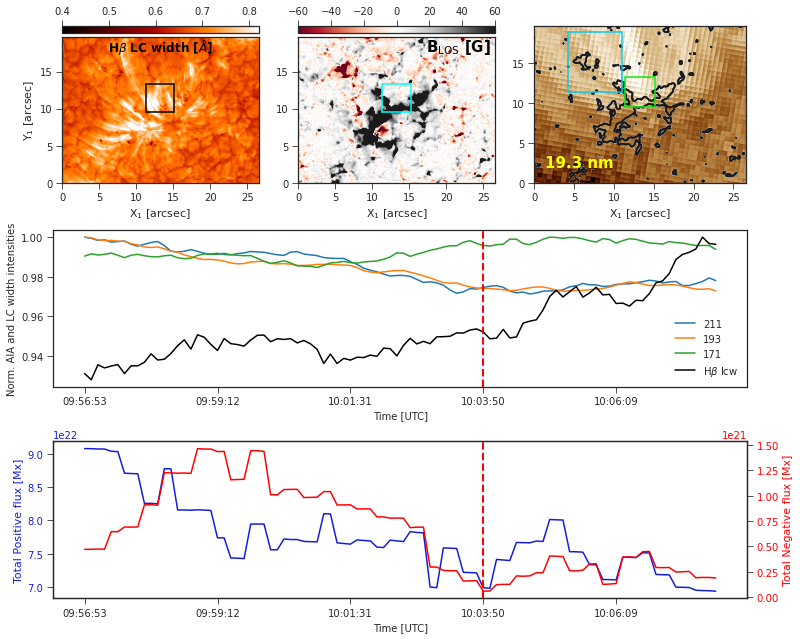

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


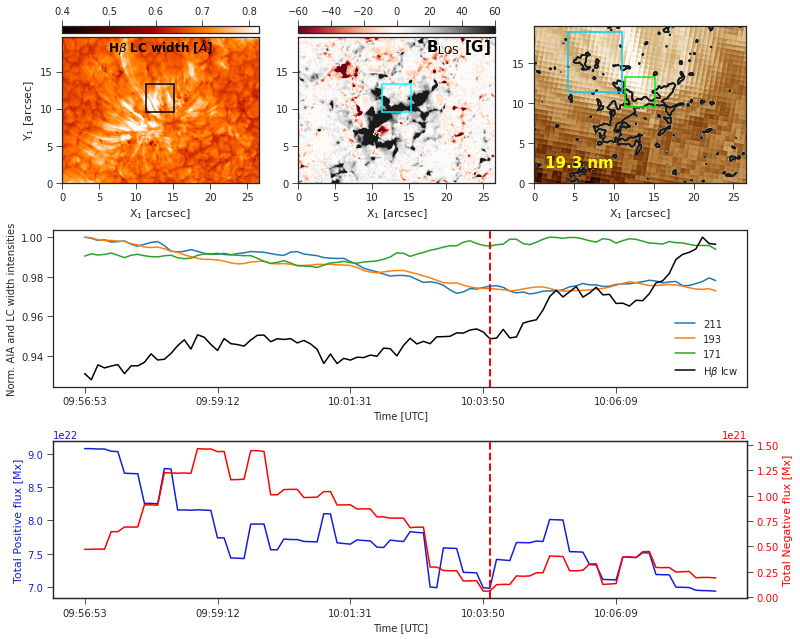

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


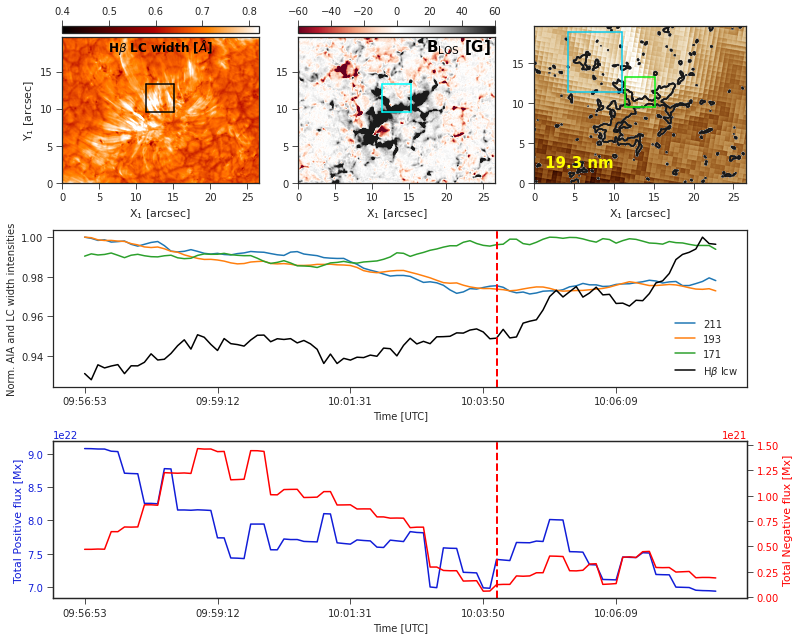

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


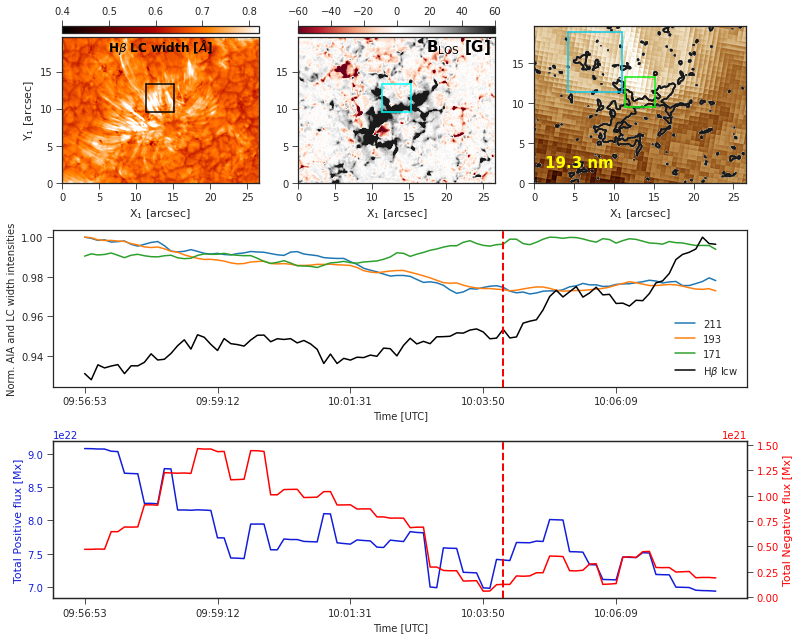

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


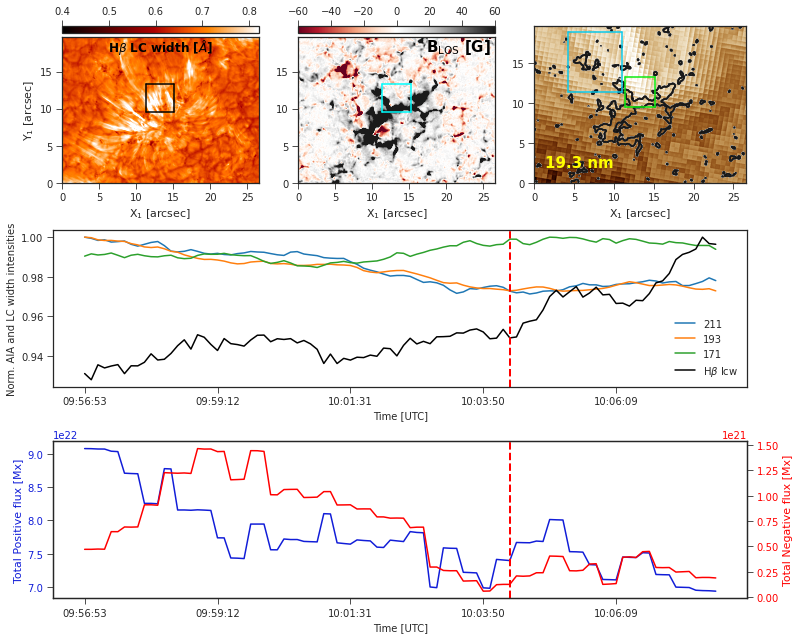

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


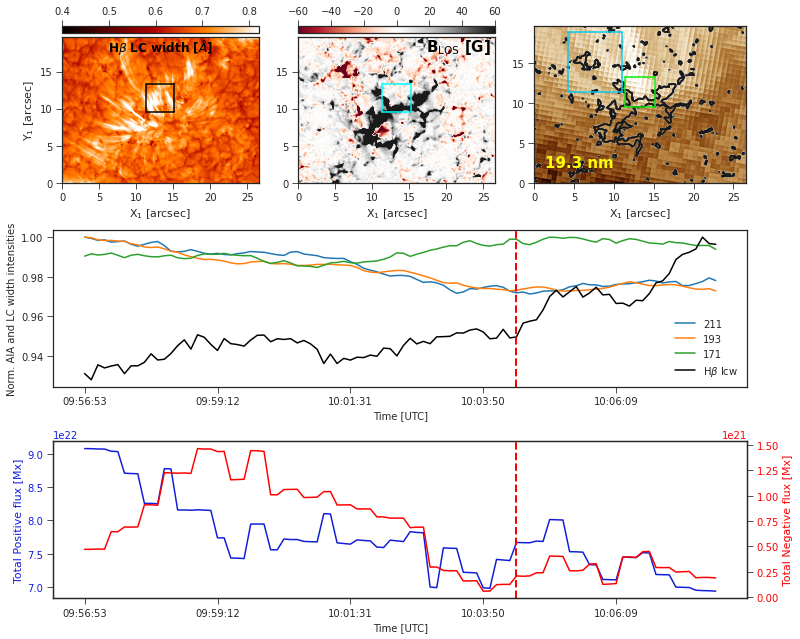

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


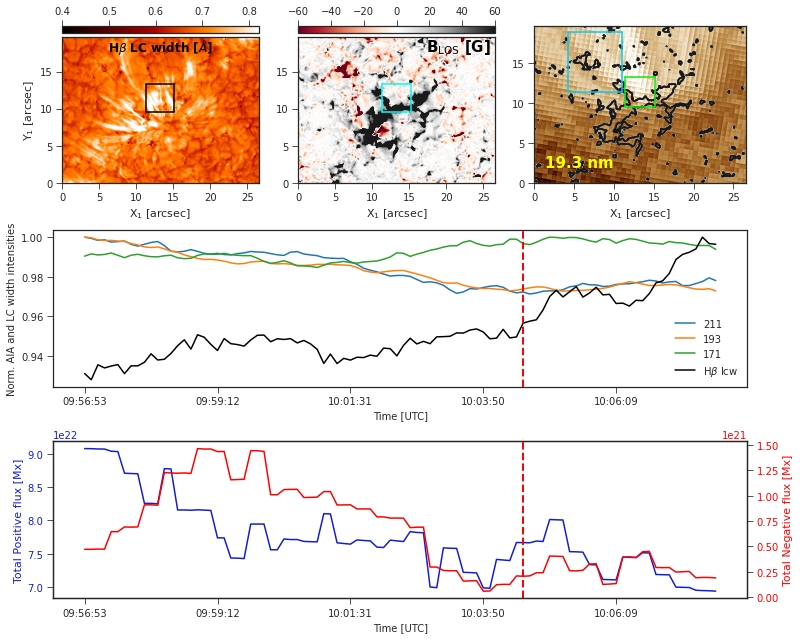

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


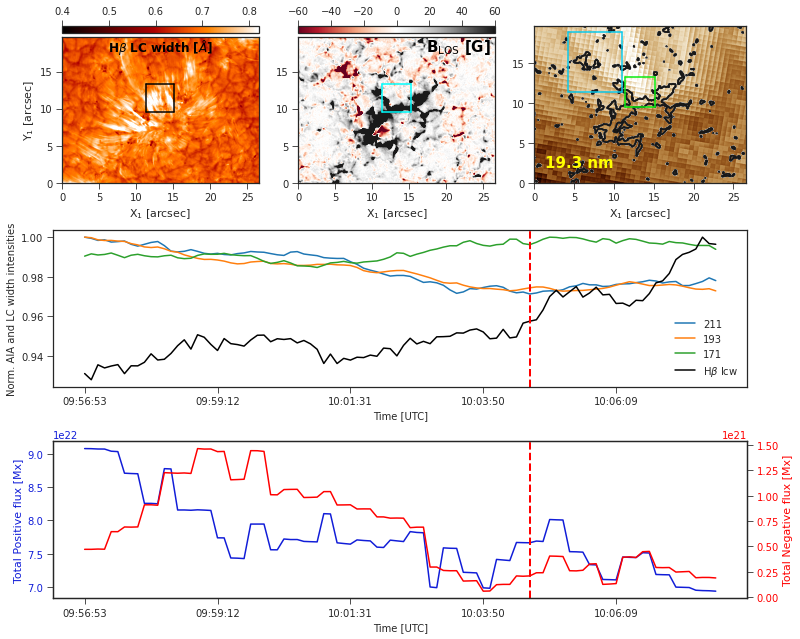

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


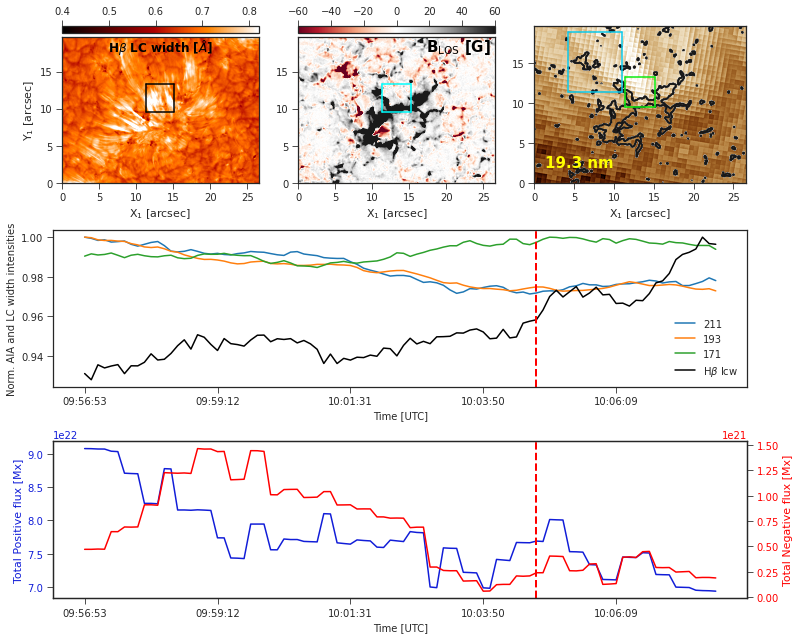

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


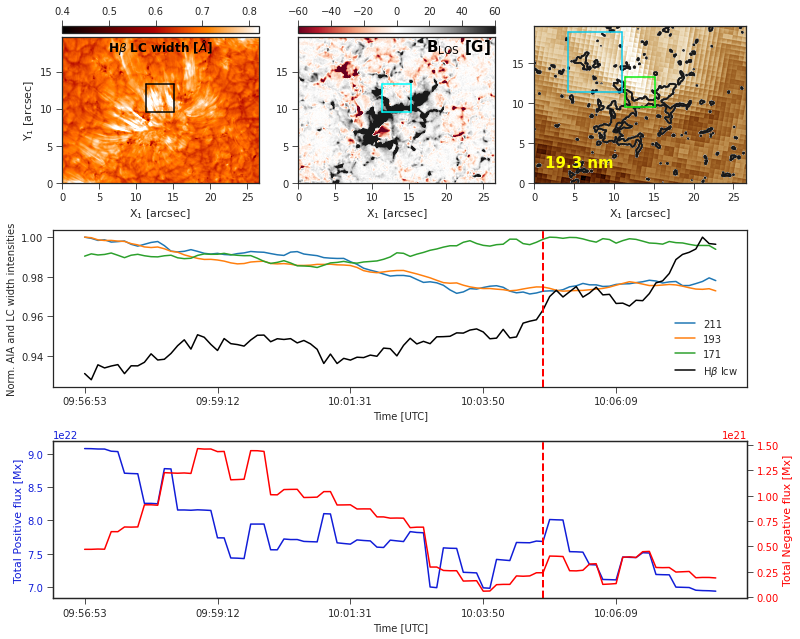

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


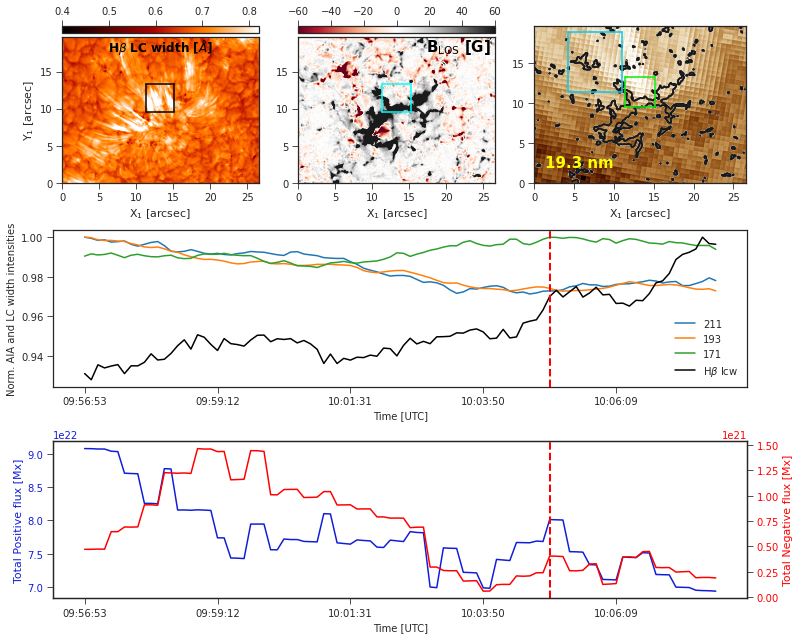

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


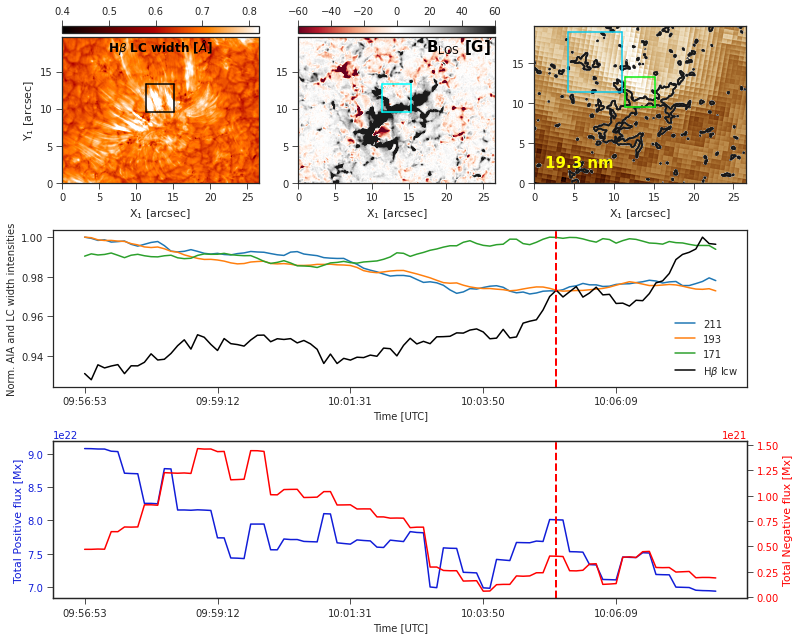

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


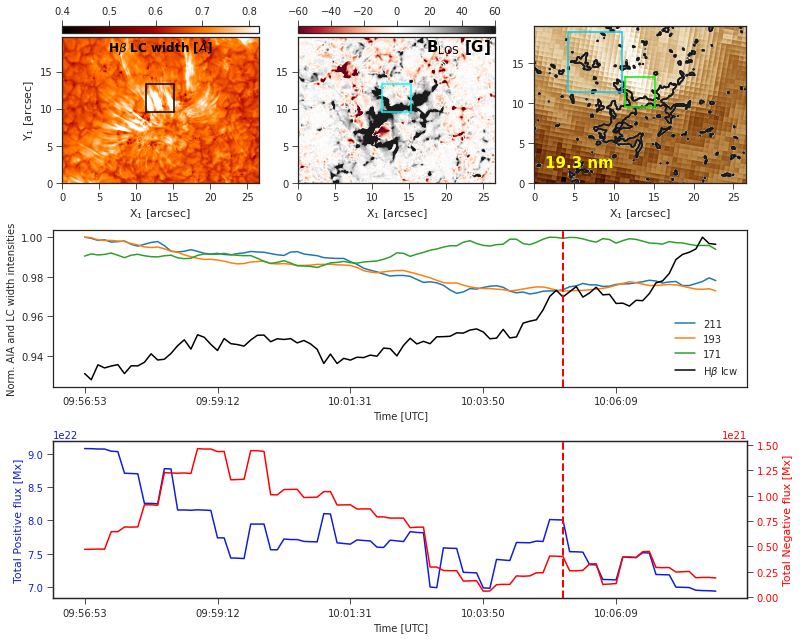

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


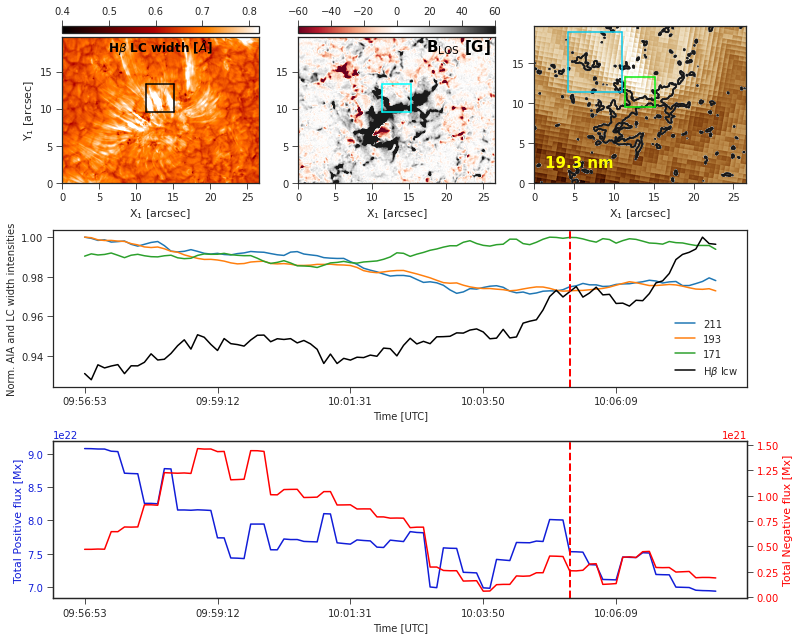

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


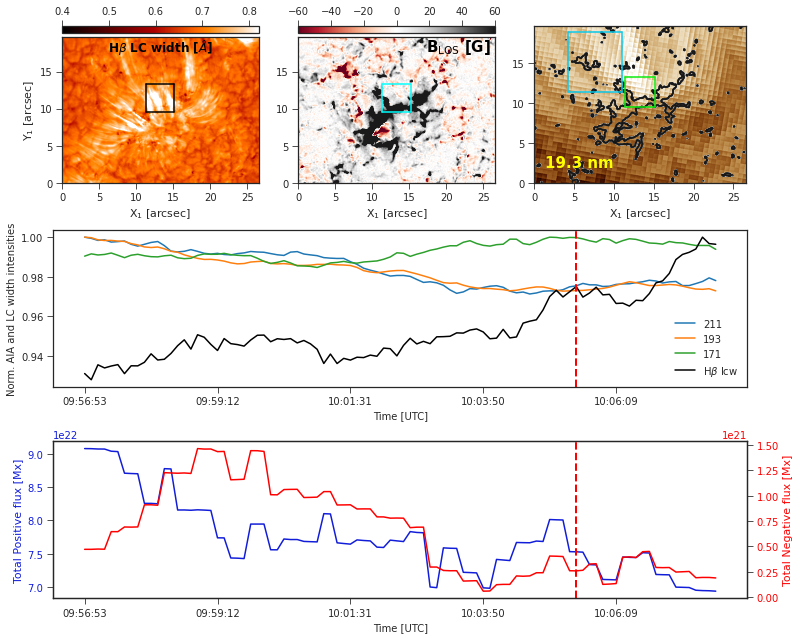

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


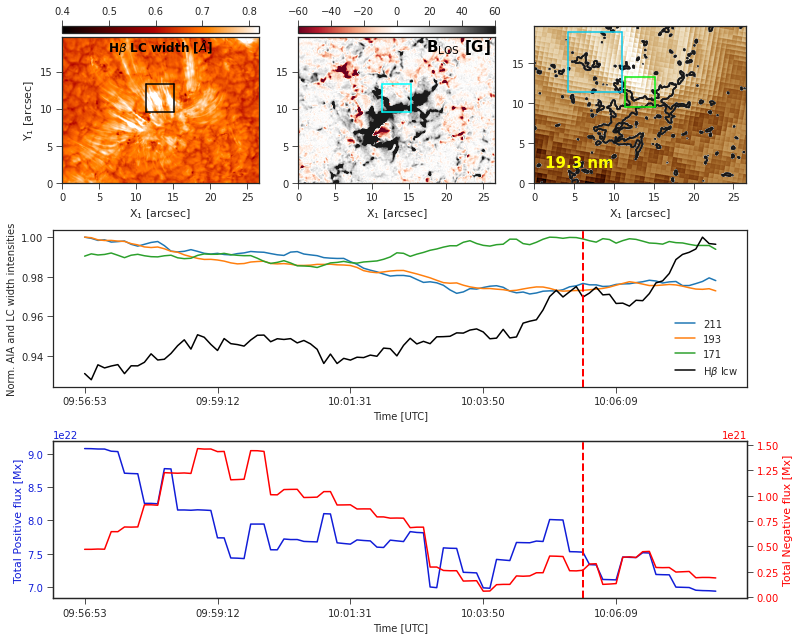

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


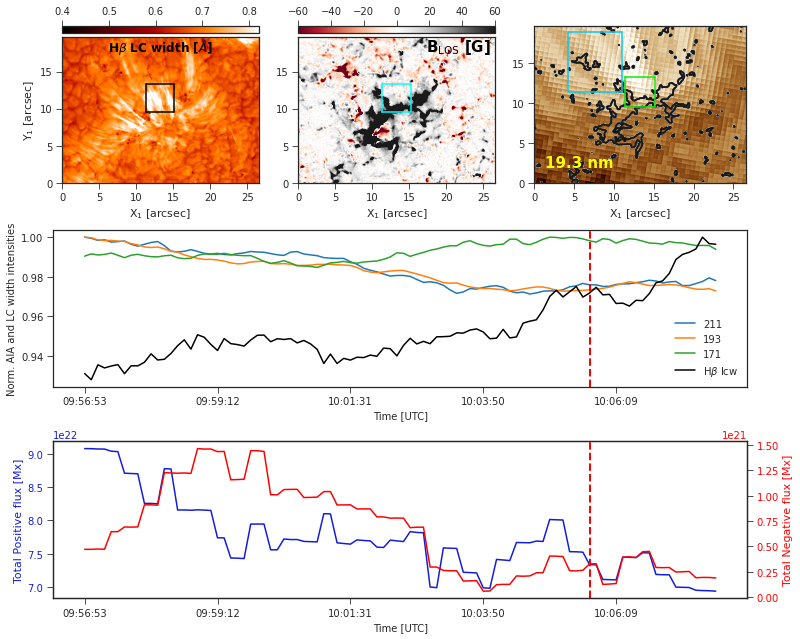

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


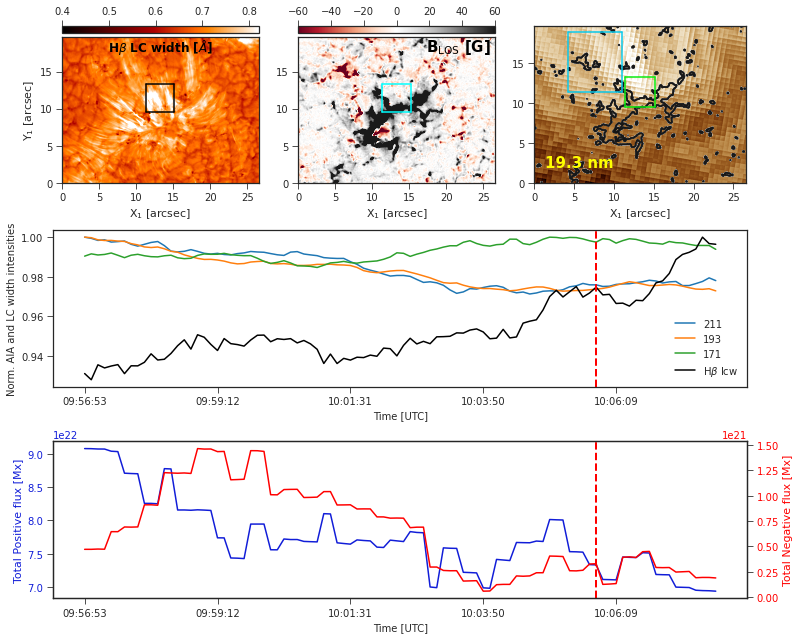

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


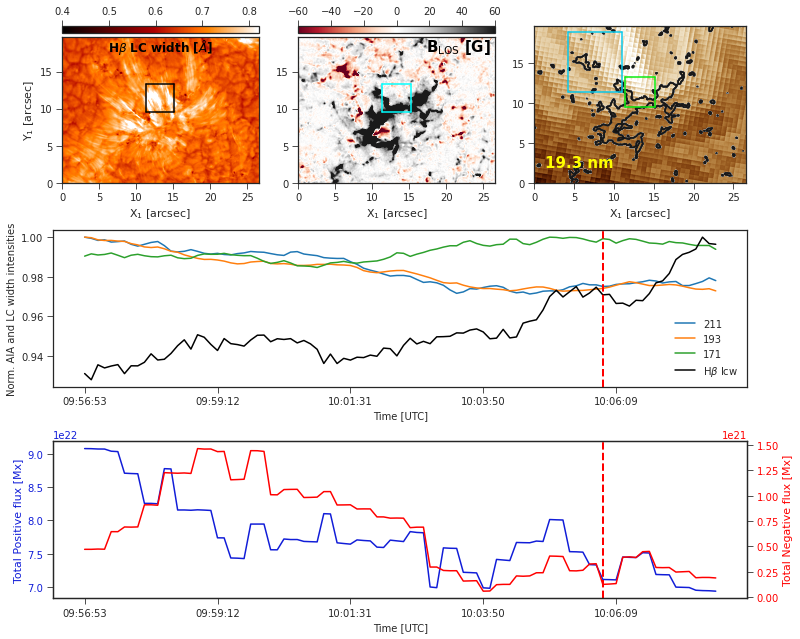

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


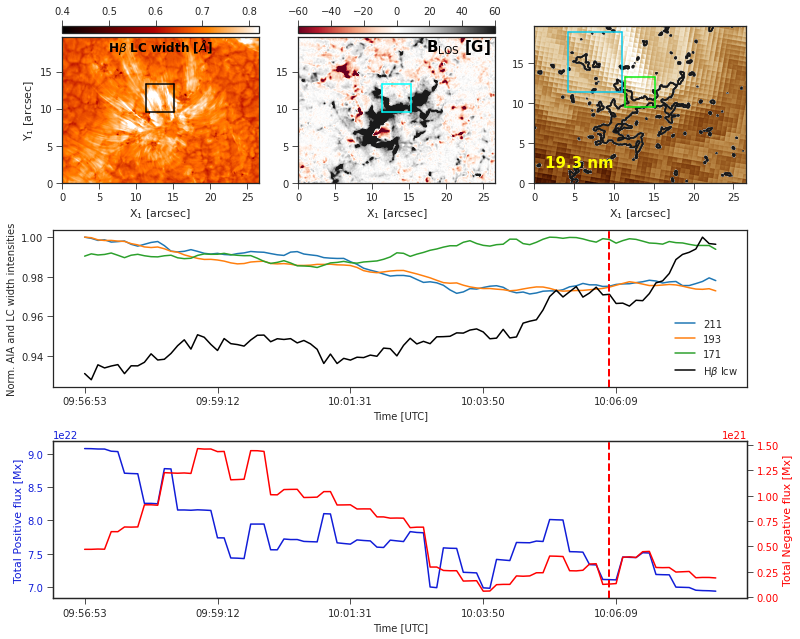

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


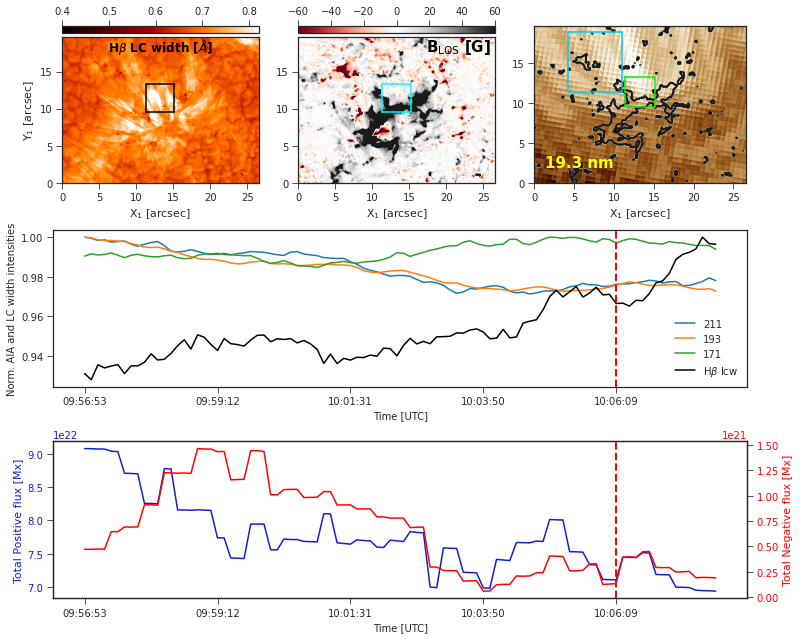

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


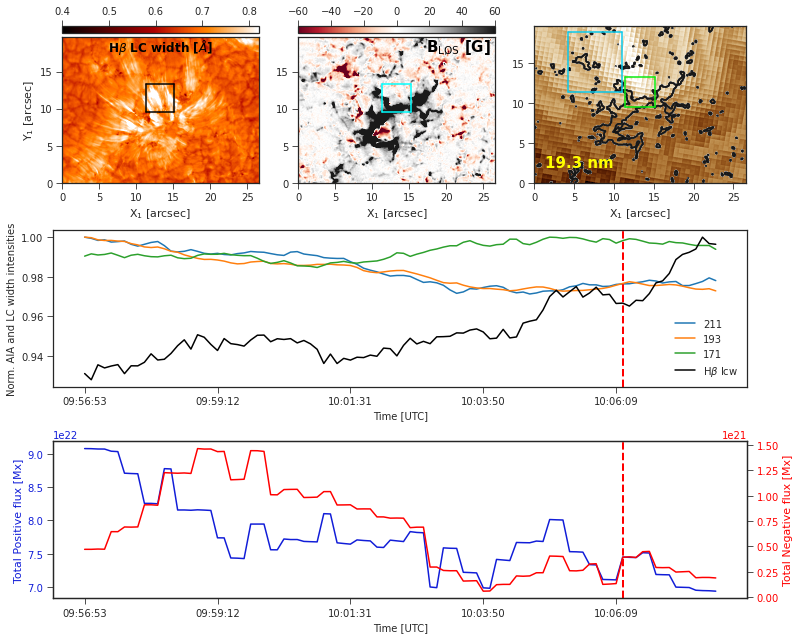

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


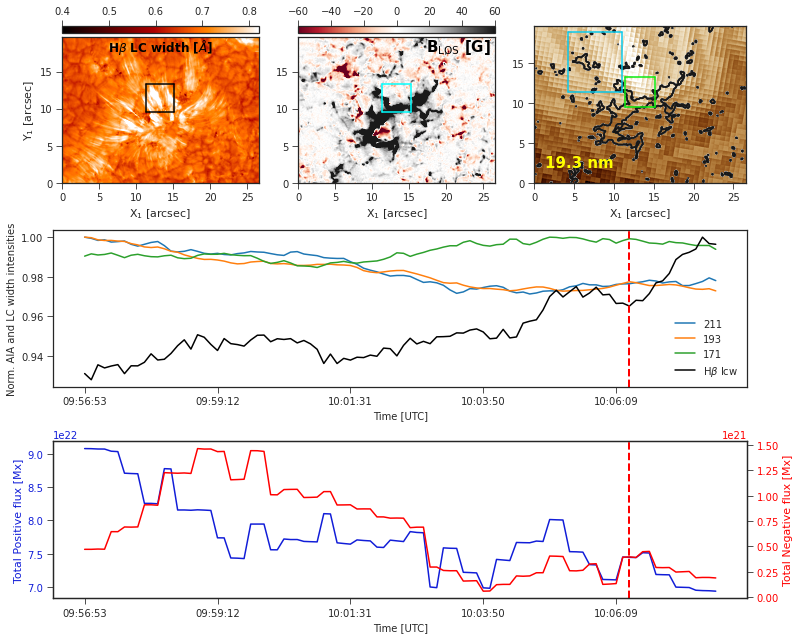

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


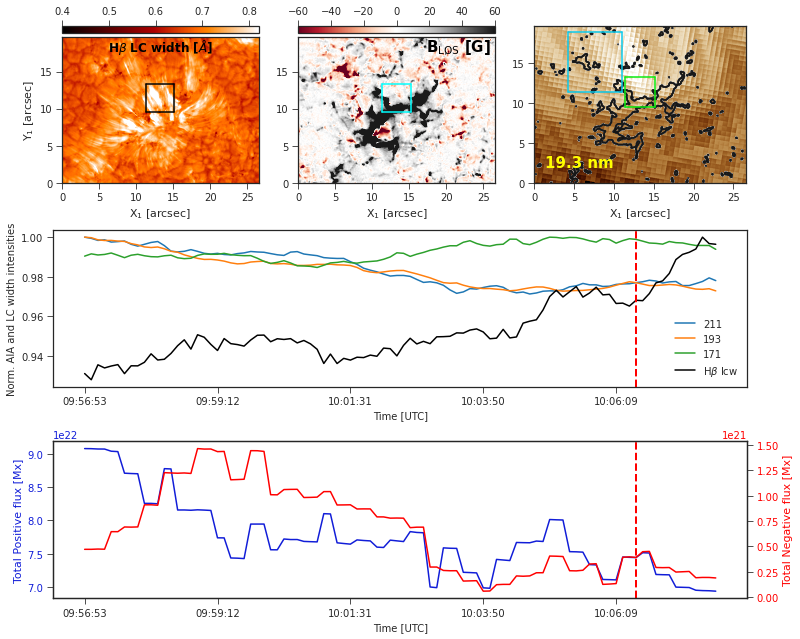

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


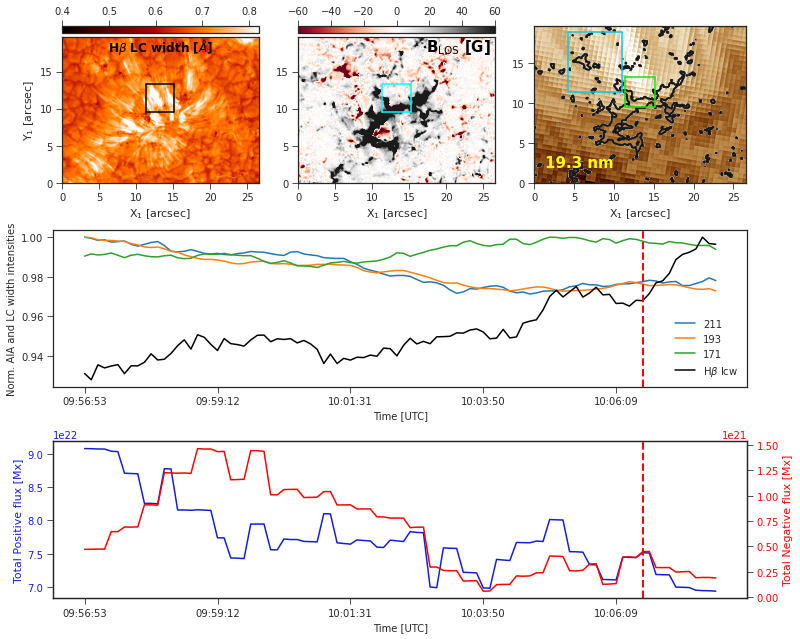

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


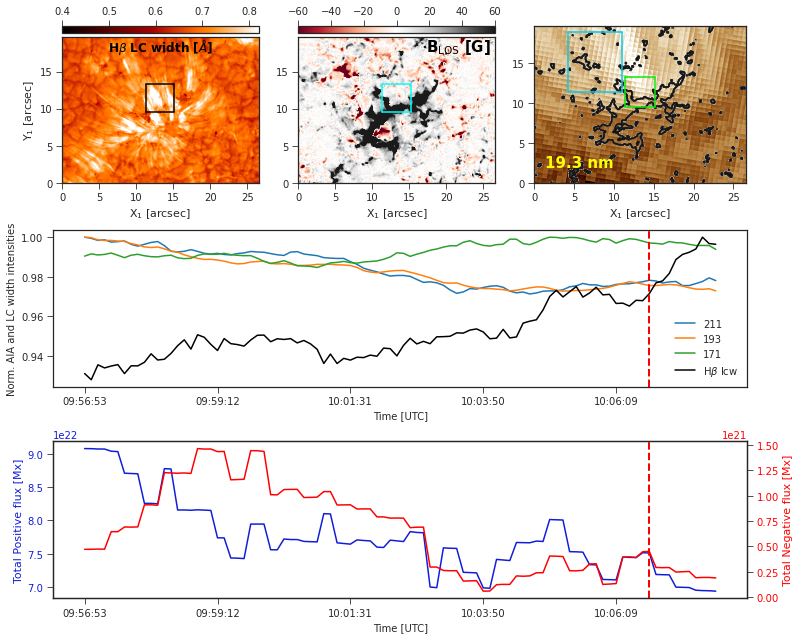

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


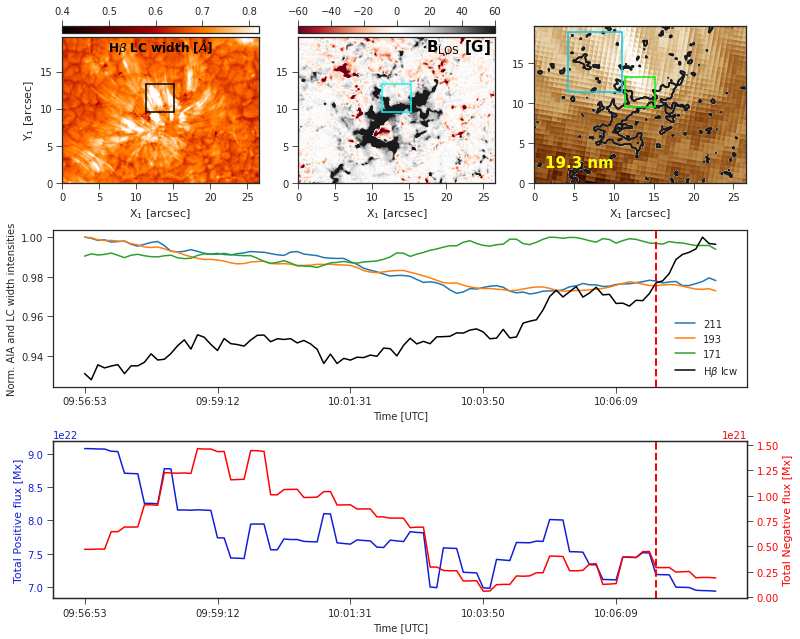

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


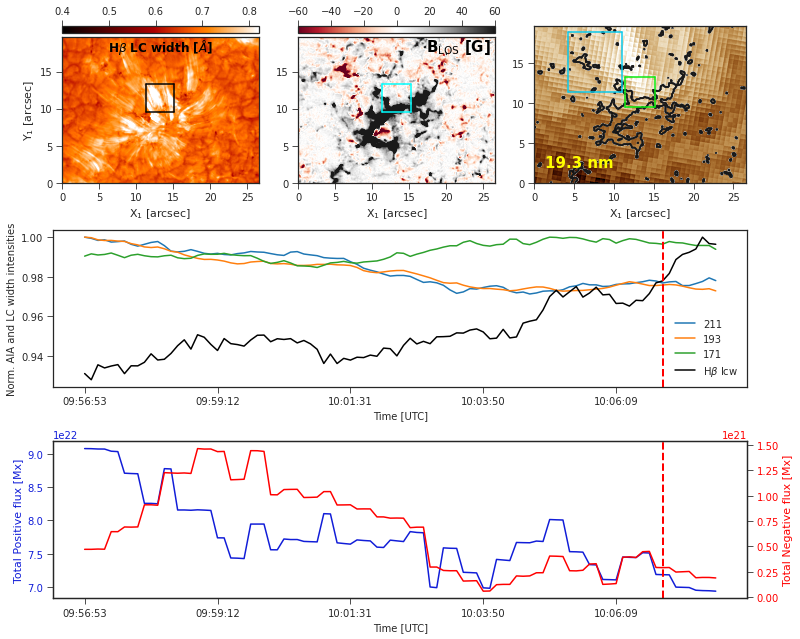

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


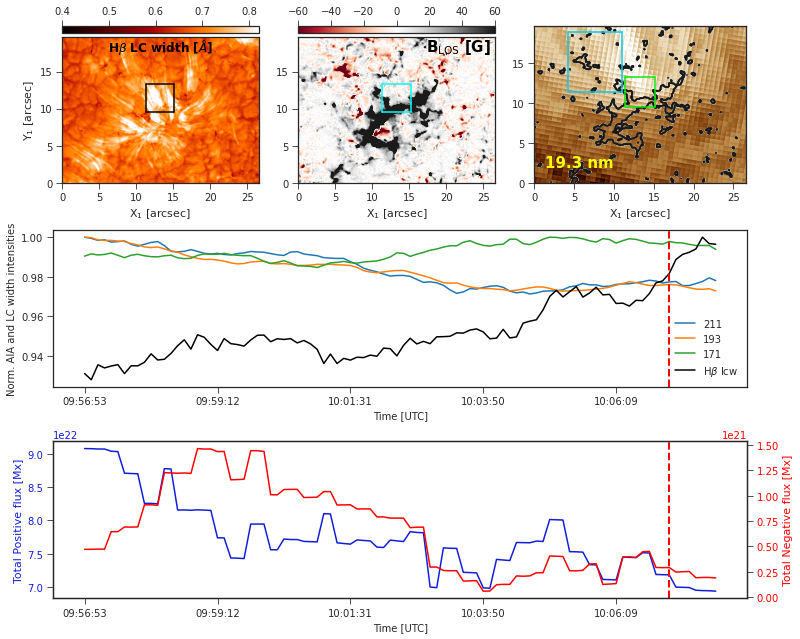

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


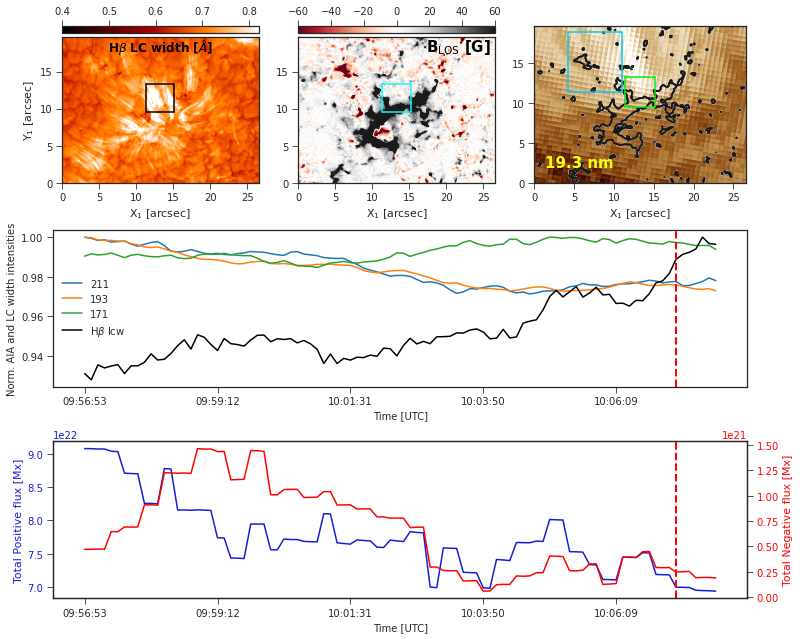

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


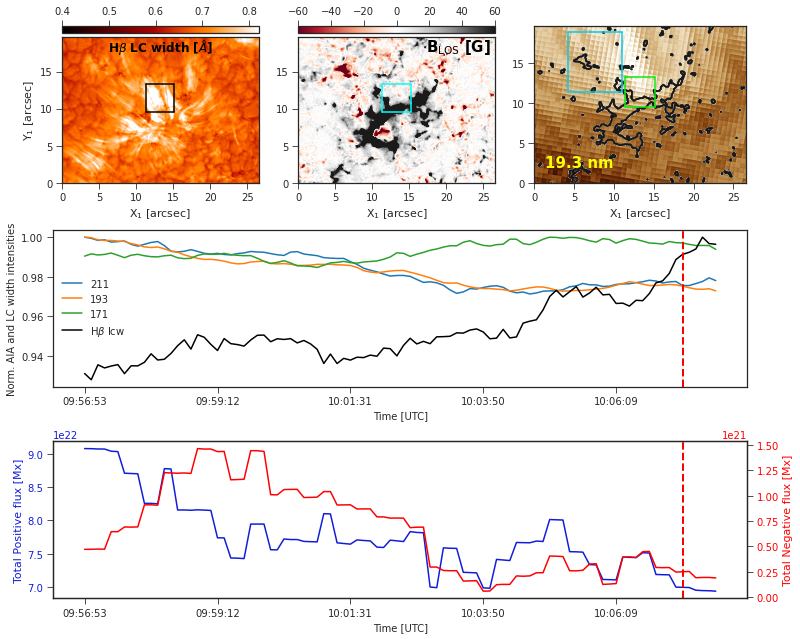

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


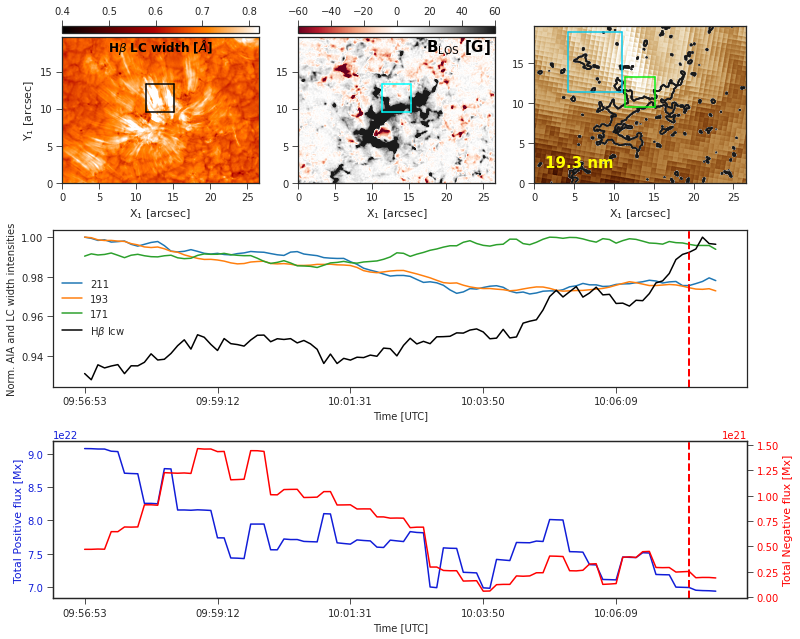

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


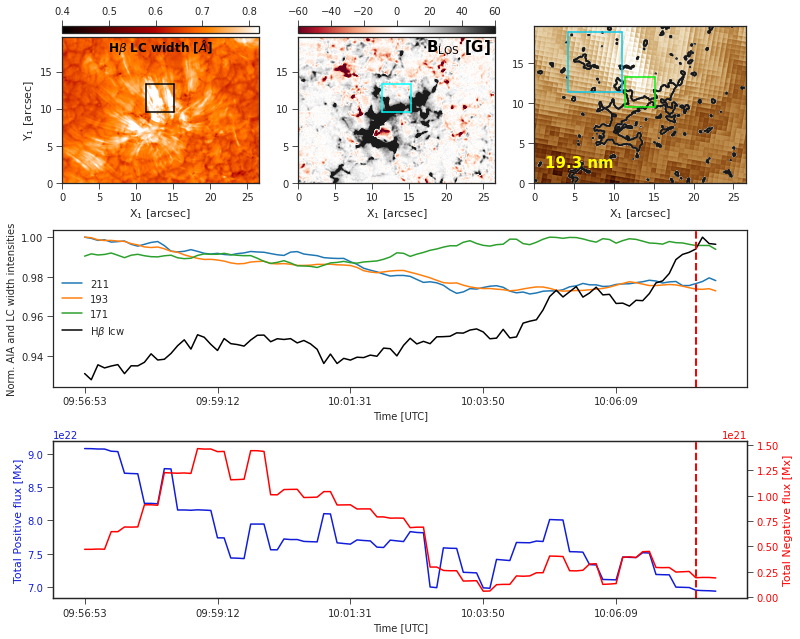

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


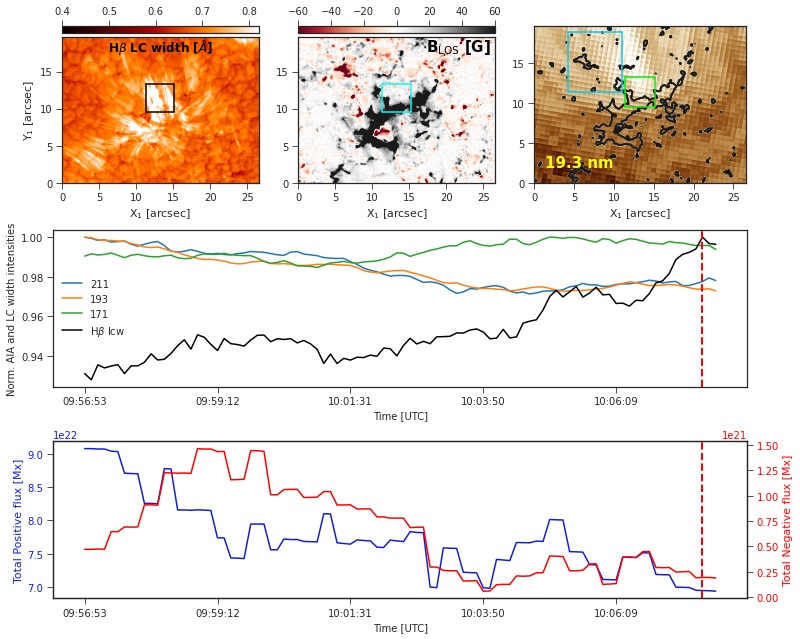

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


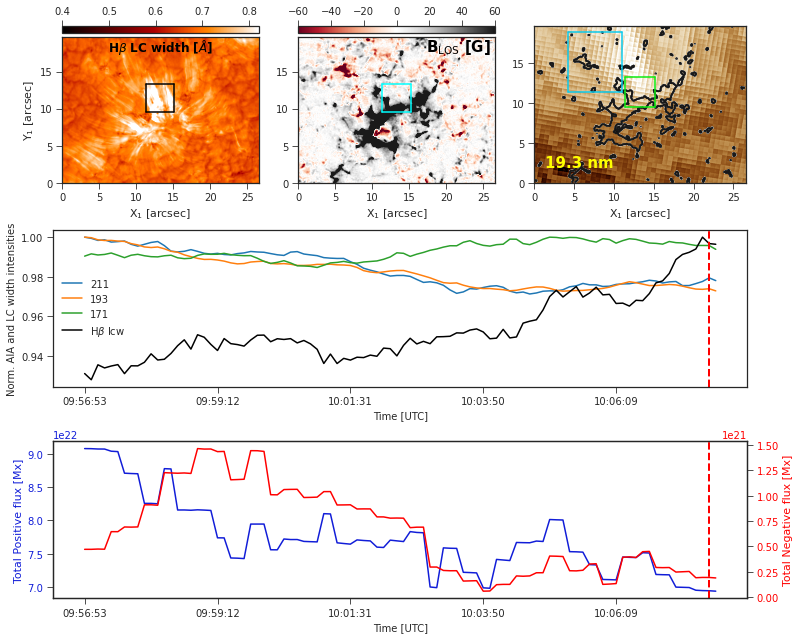

/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:116: UserWarning: FixedFormatter should only be used together with FixedLocator
/astro/local/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:127: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "pad_innches" which is no longer supported as of 3.3 and will become an error two minor releases later


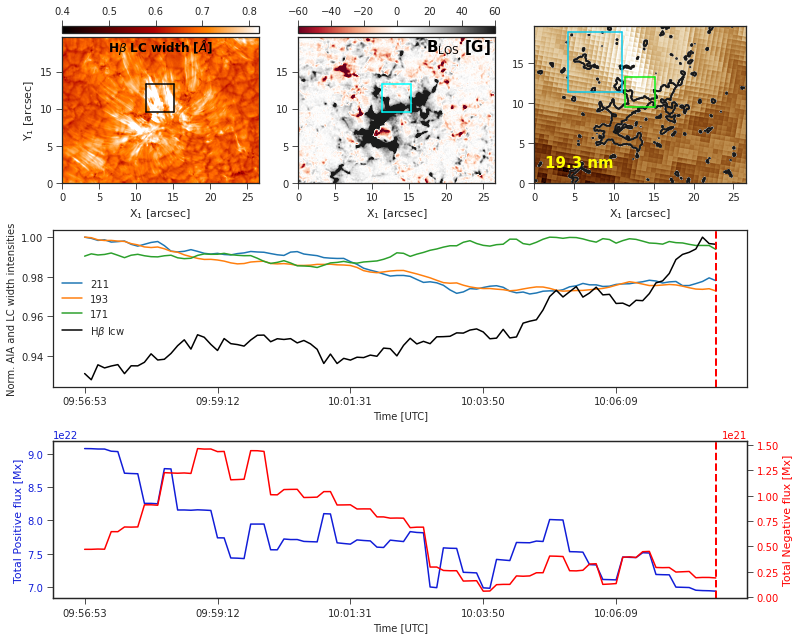

In [24]:
#----FOV-3-----

plt.style.use('seaborn-ticks')
point1 = [300*0.0379,250*0.0379]
point2 = [400*0.0379,250*0.0379]
point3 = [400*0.0379,350*0.0379]
point4 = [300*0.0379,350*0.0379]

x_values = [point1[0], point2[0]]
y_values = [point1[1], point2[1]]

x_values1 =[point3[0],point4[0]]
y_values1 =[point3[1],point4[1]]

x_values2 =[point1[0],point1[0]]
y_values2 =[point1[1],point3[1]]

x_values3 =[point2[0],point2[0]]
y_values3 =[point3[1],point2[1]]


point1_193 = [110*0.0379,300*0.0379]
point2_193 = [290*0.0379,300*0.0379]
point3_193 = [290*0.0379,500*0.0379]
point4_193 = [110*0.0379,500*0.0379]

x_values_193 = [point1_193[0], point2_193[0]]
y_values_193 = [point1_193[1], point2_193[1]]

x_values1_193 =[point3_193[0],point4_193[0]]
y_values1_193 =[point3_193[1],point4_193[1]]

x_values2_193 =[point1_193[0],point1_193[0]]
y_values2_193 =[point1_193[1],point3_193[1]]

x_values3_193 =[point2_193[0],point2_193[0]]
y_values3_193 =[point3_193[1],point2_193[1]]

for time in range(96):
    
    axs = plt.figure(constrained_layout=True,figsize=(11.,8.5)).subplot_mosaic(
    """
    ABC
    DDD
    EEE
    """
    )

#     time = 38
    mag_instant = cube_mag_los[400:1100,600:1120,time]
    mask = mag_instant*0
    mask[np.where(np.abs(mag_instant)>=50)]=1

    imc1=axs["A"].imshow(cube_lc_widths[400:1100,600:1120,time].T, origin='lower', cmap='sdoaia304',vmax=0.82,vmin=0.4,extent=[0,700*0.0379,0,520*0.0379])
    #im1=axs[0].contour(mask.T,cmap='Greys',levels=20,alpha=0.2,extent=[0,700*0.0379,0,520*0.0379])
    axs["A"].set_yticks([0,5,10,15])
    axs["A"].plot(x_values, y_values,color='black')
    axs["A"].plot(x_values1, y_values1,color='black')
    axs["A"].plot(x_values2, y_values2,color='black')
    axs["A"].plot(x_values3, y_values3,color='black')
    axs["A"].set_xlabel(r'X$_{\mathrm{1}}$ [arcsec]',size=11)
    axs["A"].set_ylabel(r'Y$_{\mathrm{1}}$ [arcsec]',size=11)
    dividerc1 = make_axes_locatable(axs["A"])
    caxc1 = dividerc1.append_axes("top", size="5%", pad=0.05)
    cbar2=plt.colorbar(imc1,cax=caxc1,orientation='horizontal',)
    cbar2.set_label(r'H$\beta$ LC width [$\AA$]',size=12,color='black',weight='bold')
    cbar2.ax.xaxis.set_ticks_position("top")

    imc2=axs["B"].imshow(cube_mag_los[400:1100,600:1120,time].T, origin='lower', cmap='RdGy',vmax=60, vmin=-60,extent=[0,700*0.0379,0,520*0.0379])
    axs["B"].set_yticks([0,5,10,15])
    #axs["B"].set_xticks([])
    axs["B"].plot(x_values, y_values,color='cyan')
    axs["B"].plot(x_values1, y_values1,color='cyan')
    axs["B"].plot(x_values2, y_values2,color='cyan')
    axs["B"].plot(x_values3, y_values3,color='cyan')
    axs["B"].set_xlabel(r'X$_{\mathrm{1}}$ [arcsec]',size=11)
    axs["B"].text(.65, .9, r'B$_{\mathrm{LOS}}$ [G]', transform=axs["B"].transAxes, fontsize=15,color='black',weight='bold')
    dividerc1 = make_axes_locatable(axs["B"])
    caxc1 = dividerc1.append_axes("top", size="5%", pad=0.05)
    cbar2=plt.colorbar(imc2,cax=caxc1,orientation='horizontal')
    #cbar2.set_label(r'B$_{\mathrm{LOS}}$ [G]',size=13,color='#03af37',weight='bold')
    #cbar2.ax.xaxis.set_tick_params(color='red')
    cbar2.ax.xaxis.set_ticks_position("top")

    axs["C"].imshow(mgn_193[400:1100,600:1120,time].T, origin='lower', cmap='sdoaia193',vmin=0.2,vmax=0.75,extent=[0,700*0.0379,0,520*0.0379])
    im1=axs["C"].contour(mask.T,cmap='Greys',levels=20,alpha=0.6,extent=[0,700*0.0379,0,520*0.0379])
    axs["C"].set_yticks([0,5,10,15])
    #axs["C"].set_xticks([])
    axs["C"].plot(x_values_193, y_values_193,color='#09caed')
    axs["C"].plot(x_values1_193, y_values1_193,color='#09caed')
    axs["C"].plot(x_values2_193, y_values2_193,color='#09caed')
    axs["C"].plot(x_values3_193, y_values3_193,color='#09caed')
    axs["C"].plot(x_values, y_values,color='#09ed10')
    axs["C"].plot(x_values1, y_values1,color='#09ed10')
    axs["C"].plot(x_values2, y_values2,color='#09ed10')
    axs["C"].plot(x_values3, y_values3,color='#09ed10')
    axs["C"].text(.05, .1, r'19.3 nm', transform=axs["C"].transAxes, fontsize=15,color='yellow',weight='bold')
    axs["C"].set_xlabel(r'X$_{\mathrm{1}}$ [arcsec]',size=11)
    
    axs["D"].plot(times,I_light_211_int/np.max(I_light_211_int), label='211')
    axs["D"].plot(times,I_light_193_int/np.max(I_light_193_int), label='193')
    axs["D"].plot(times,I_light_171_int/np.max(I_light_171_int), label='171')
    #axs["D"].plot(I_light_304/np.max(I_light_304), label='304')
    axs["D"].plot(times,I_lc_Hbeta/np.max(I_lc_Hbeta), color='black',label=r'H$\beta$ lcw')
    axs["D"].legend(loc='best')
    axs["D"].axvline(x=time,color='red',linewidth=2,linestyle='dashed')
    axs["D"].set_xticks([times[0],times[20],times[40],times[60],times[80]])
    axs["D"].set_xticklabels(labels =[time_str[0],time_str[20],time_str[40],time_str[60],time_str[80]])
    axs["D"].set_ylabel('Norm. AIA and LC width intensities')
    #axs["D"].axvspan(times[45], times[65],alpha=0.3, color ='gray')
    axs["D"].set_xlabel('Time [UTC]')
    
    axs["E"].plot(times,pos_mag, color='#111dd8')#'#d816c4')
    axs["E"].set_ylabel(r'Total Positive flux [Mx]',color='#111dd8',size=11)
    axs["E"].tick_params(axis='y', labelcolor='#111dd8')
    axs["E"].set_xticklabels(labels =[time_str[0],time_str[20],time_str[40],time_str[60],time_str[80]])
    axs["E"].set_xticks([times[0],times[20],times[40],times[60],times[80]])
    axs["E"].axvline(x=time,color='red',linewidth=2,linestyle='dashed')
    #axs["E"].axvspan(times[45], times[65],alpha=0.3, color ='gray')
    axs["E"].set_xlabel('Time [UTC]')
    
    ax2=axs["E"].twinx()
    color ='red'
    ax2.set_ylabel(r'Total Negative flux [Mx]',color=color,size=11)
    ax2.plot(neg_mag,color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    plt.savefig('/mn/stornext/d9/souvikb/CBP_spicules_SDO/movies_FE_new/FE_spicule_CBP_FOV3_flux-'+str(time)+'.png',dpi=300,bbox_inches = 'tight',pad_innches=0.1)
    plt.show()